In [54]:
import os
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.ticker as mticker
from cartopy.mpl.ticker import (LongitudeFormatter, LatitudeFormatter)

In [85]:
# Set results path, experiment filename, path to save figures and path to predictors dataset
# Results path and file name
project_dir = '/Users/huripari/Documents/PhD/TCs_Genesis'
n_clusters = 12
n_vars = 4
n_idxs = 10
target_file = 'target_1965-2022_2.5x2.5.csv'
output_folder = 'test'
model_kind = 'MLPReg' # 'LinReg' or 'LogReg' or 'MLPReg

fs_dir = os.path.join(project_dir, 'FS_TCG')
output_dir = os.path.join(fs_dir, 'results', output_folder)
experiment_filename = f'1965-2022_{n_clusters}clusters_{n_vars}vars_{n_idxs}idxs.csv'
sol_filename = f'{model_kind}_' + experiment_filename
sol_path = os.path.join(output_dir, sol_filename)
final_sol_path = os.path.join(output_dir, f'CRO_{sol_filename}')

path = './Results/' 
path_figures = './Results/Figures/'

data_dir = os.path.join(fs_dir, 'data', f'{n_clusters}clusters')
predictor_file = 'predictors_' + experiment_filename
predictors_path = os.path.join(data_dir, predictor_file)
target_path = os.path.join(data_dir, target_file)

pred_path = './Data/Paper/'
pred_file = 'predictors_dataset.csv'

In [86]:
pred_dataframe_opt = pd.read_csv(predictors_path, index_col=0)
pred_dataframe_opt.index = pd.to_datetime(pred_dataframe_opt.index)

In [87]:
files_labels = os.listdir(data_dir)
files_labels = [file for file in files_labels if file.startswith('label')]
files_labels.sort()

# for label_file in files_labels:
#     label_df = pd.read_csv(os.path.join(data_dir, label_file), index_col=0)
    
#     # Set the figure and domain extension
#     north, south = label_df['nodes_lat'].iloc[0], label_df['nodes_lat'].iloc[-1]
#     west, east = label_df['nodes_lon'].iloc[0], label_df['nodes_lon'].iloc[-1]
#     fig = plt.figure(figsize=(30, 6))
#     ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=180))
#     ax.set_extent([west, east, south, north], crs=ccrs.PlateCarree())
#     ax.coastlines(resolution='110m', linewidth=2)
#     ax.add_feature(cfeature.BORDERS, linestyle=':')

#     # Set the gridlines of the map 
#     gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
#     gl.top_labels = False
#     gl.right_labels = False
#     gl.xformatter = LongitudeFormatter()
#     gl.yformatter = LatitudeFormatter()
#     gl.xlocator = mticker.FixedLocator(np.arange(-180, 181, 20))
#     gl.ylocator = mticker.FixedLocator(np.arange(-90, 91, 10))
#     gl.xlabel_style = {'size': 20} 
#     gl.ylabel_style = {'size': 20}

#     # Get data for the plot and plot the clusters
#     n_clusters = len(np.unique(label_df['cluster']))
#     cmap = plt.cm.get_cmap('tab20', n_clusters)
#     scatter = ax.scatter(label_df['nodes_lon'].values, label_df['nodes_lat'].values, c=label_df['cluster'], cmap=cmap, s=400, transform=ccrs.PlateCarree())

#     # Add colorbar
#     bounds = np.arange(n_clusters + 1) - 0.5
#     cbar = plt.colorbar(scatter, ticks=np.arange(n_clusters), boundaries=bounds, ax=ax, orientation='vertical')
#     cbar.set_ticklabels(np.arange(n_clusters)+1)
#     cbar.ax.tick_params(labelsize=22)
#     cbar.set_label('Cluster',fontsize=26)

#     ax.set_title(label_file[7:-9], fontsize=30)

#     plt.tight_layout()
#     plt.show()

In [88]:
sol_file_df = pd.read_csv(sol_path, sep=' ', header=0)
sol_file_df.head()

,CV,Test,Sol
0,6.268782,9.010808,[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1...
1,7.049397,10.027613,[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1...
2,6.718144,10.250850,[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1...
3,7.004167,8.571444,[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1...
4,6.683226,11.403331,[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1...


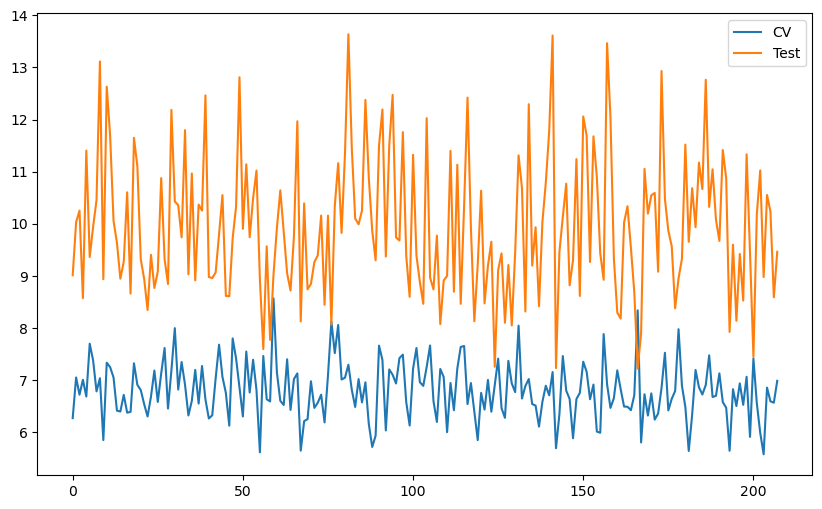

In [89]:
plt.figure(figsize=(10, 6))
plt.plot(sol_file_df.index, sol_file_df['CV'], label='CV')
plt.plot(sol_file_df.index, sol_file_df['Test'], label='Test')
plt.legend()

In [90]:
# sol_file_df.drop_duplicates(subset=['Sol'], inplace=True)
# sol_file_df.shape

 
0.4912 x + 6.608


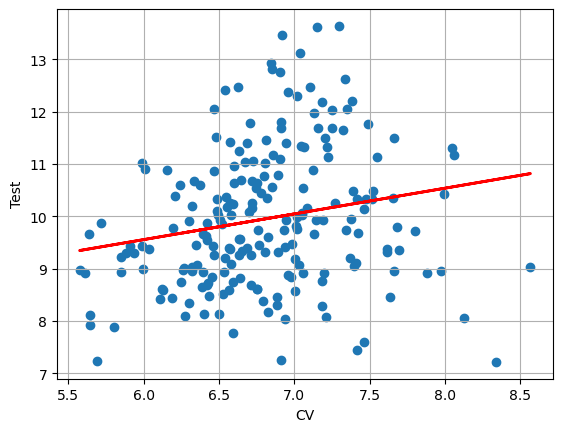

In [91]:
plt.scatter(sol_file_df['CV'],sol_file_df['Test'])
z = np.polyfit(sol_file_df['CV'], sol_file_df['Test'], 1)
p = np.poly1d(z)
#add trendline to plot
plt.plot(sol_file_df['CV'], p(sol_file_df['CV']), "r-", linewidth=2.0,)
plt.xlabel('CV')
plt.ylabel('Test')
plt.grid()
print(p)

In [92]:
array_best = np.fromstring(sol_file_df.Sol[sol_file_df.sort_values(by=['CV'],ascending=False).index[0]].replace('[', '').replace(']', '').replace('\n', ''), dtype=float, sep=' ')

array_best

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0.,
       0., 0., 1., 0., 1., 1., 1., 1., 0., 1., 0., 0., 0., 1., 1., 0., 1.,
       0., 1., 0., 1., 0., 0., 1., 0., 1., 0., 1., 0., 1., 1., 0., 1., 0.,
       1., 0., 1., 1., 1., 0., 1., 1., 0., 1., 0., 0., 0., 1., 1., 0., 0.,
       0., 1., 0., 1., 0., 1., 1., 0., 0., 0., 0., 0., 1., 1., 1., 1., 0.,
       1., 1., 1., 1., 1., 0., 1., 1., 1., 1., 0., 1., 1., 0., 1., 0., 0.,
       0., 0., 0., 1., 1., 0., 0., 1., 1., 1., 0., 1., 1., 1., 0., 1., 0.,
       1., 1., 1., 1.])

 
0.4912 x + 6.608


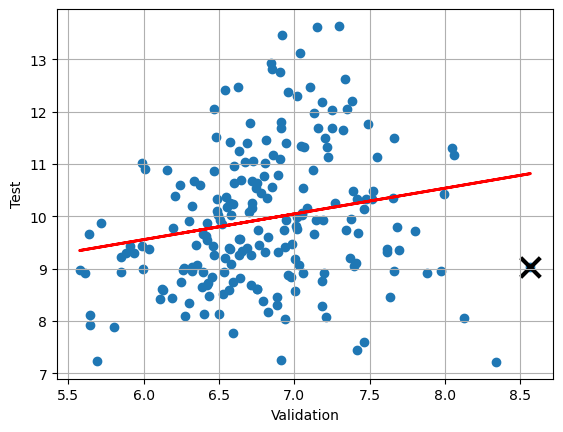

In [93]:
plt.scatter(sol_file_df['CV'],sol_file_df['Test'])
z = np.polyfit(sol_file_df['CV'], sol_file_df['Test'], 1)
p = np.poly1d(z)
plt.scatter(sol_file_df.CV[sol_file_df.sort_values(by=['CV'],ascending=False).index[0]],sol_file_df.Test[sol_file_df.sort_values(by=['CV'],ascending=False).index[0]],color='black',marker='x',s=200,linewidths=3)
#add trendline to plot
plt.plot(sol_file_df['CV'], p(sol_file_df['CV']), "r-", linewidth=2.0,)
plt.xlabel('Validation')
plt.ylabel('Test')
plt.grid()
print(p)

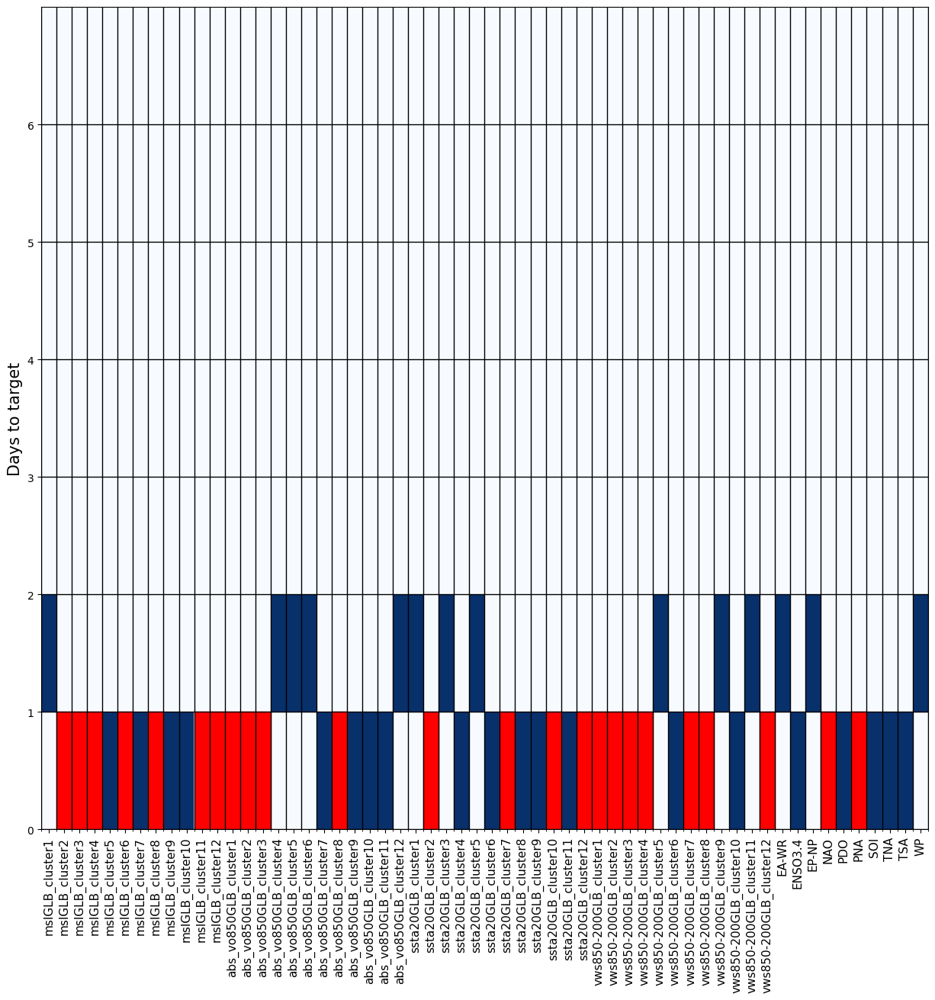

In [94]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator

def create_board(n_rows, n_cols, final_sequence, sequence_length):
    board = np.zeros((n_rows, n_cols))
    
    # Establecer los cuadrados azules
    for i in range(n_cols):
        start_index = int(final_sequence[i]) 
        end_index = int(final_sequence[i])  + int(sequence_length[i])
        if feat_sel[i] != 0:
            board[start_index:end_index, i] = 1
    
    return board

def plot_board(board, column_names):
    plt.figure(figsize=(15, 14))
    plt.imshow(board, cmap='Blues', origin='lower',aspect='auto')
    plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
    plt.yticks(np.arange(board.shape[0])-0.5,np.arange(board.shape[0]))
    minor_locator = AutoMinorLocator(2)
    plt.gca().xaxis.set_minor_locator(minor_locator)
    
    plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
    plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
    # plt.grid(color='black', linewidth=1)
    plt.ylabel('Days to target',fontsize=15)

    for i in range(board.shape[1]):
        if feat_sel[i] == 0:
            rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
            plt.gca().add_patch(rect)

    plt.show()

column_names = pred_dataframe_opt.columns.tolist()
final_sequence = array_best[len(column_names):2*len(column_names)]
sequence_length = array_best[:len(column_names)]
feat_sel = array_best[2*len(column_names):]


n_rows = int(((sequence_length + final_sequence)*feat_sel).max())+5
n_cols = len(column_names)

board_best = create_board(n_rows, n_cols, final_sequence, sequence_length)

plot_board(board_best, column_names)



In [75]:
files_labels

['labels_abs_vo1000GLB12.csv',
 'labels_abs_vo500GLB12.csv',
 'labels_abs_vo600GLB12.csv',
 'labels_abs_vo850GLB12.csv',
 'labels_mgu200GLB12.csv',
 'labels_mgu250GLB12.csv',
 'labels_mgu500GLB12.csv',
 'labels_mgu50GLB12.csv',
 'labels_mgu600GLB12.csv',
 'labels_mgu850GLB12.csv',
 'labels_mgv200GLB12.csv',
 'labels_mgv250GLB12.csv',
 'labels_mgv500GLB12.csv',
 'labels_mgv50GLB12.csv',
 'labels_mgv600GLB12.csv',
 'labels_mgv850GLB12.csv',
 'labels_mpiGLB12.csv',
 'labels_mslGLB12.csv',
 'labels_r1000GLB12.csv',
 'labels_r100GLB12.csv',
 'labels_r200GLB12.csv',
 'labels_r300GLB12.csv',
 'labels_r400GLB12.csv',
 'labels_r500GLB12.csv',
 'labels_r50GLB12.csv',
 'labels_r600GLB12.csv',
 'labels_r700GLB12.csv',
 'labels_r800GLB12.csv',
 'labels_r850GLB12.csv',
 'labels_r900GLB12.csv',
 'labels_sstGLB12.csv',
 'labels_ssta20GLB12.csv',
 'labels_ssta30GLB12.csv',
 'labels_vo1000GLB12.csv',
 'labels_vo500GLB12.csv',
 'labels_vo600GLB12.csv',
 'labels_vo850GLB12.csv',
 'labels_vws250-50GLB12.cs

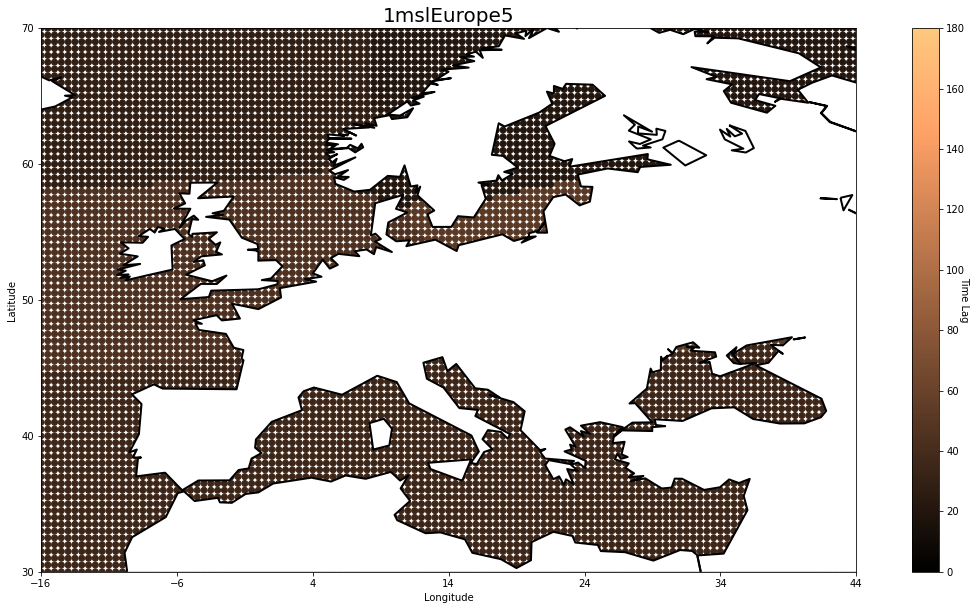

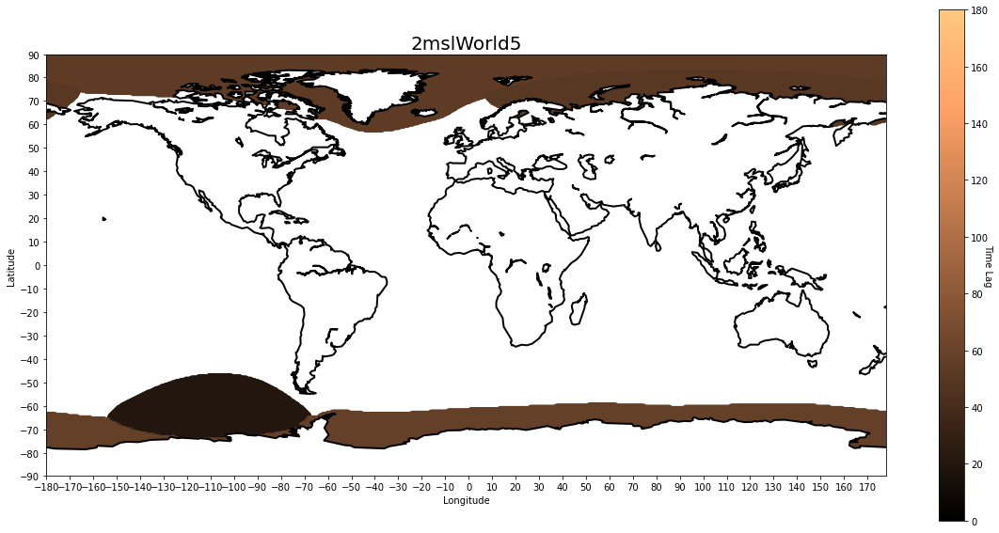

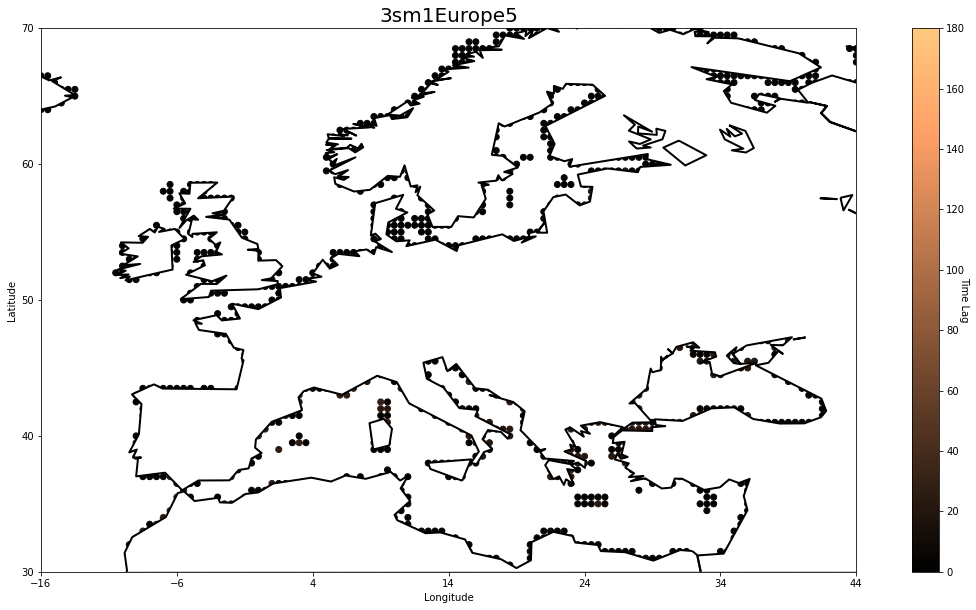

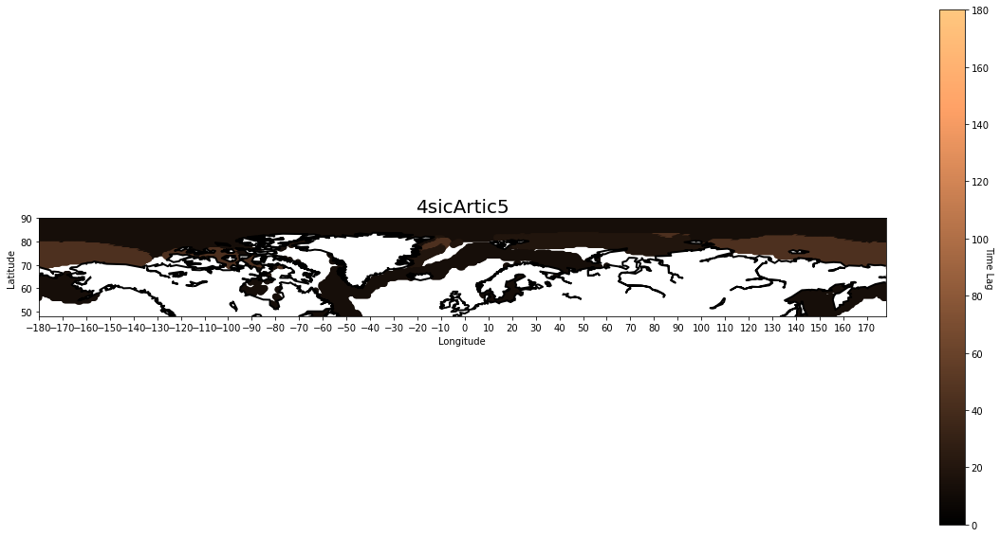

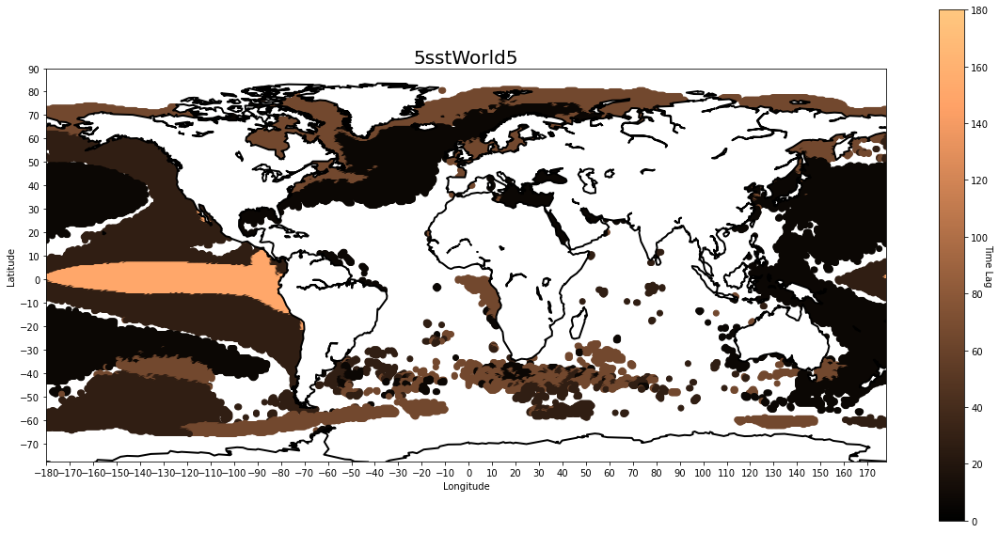

...

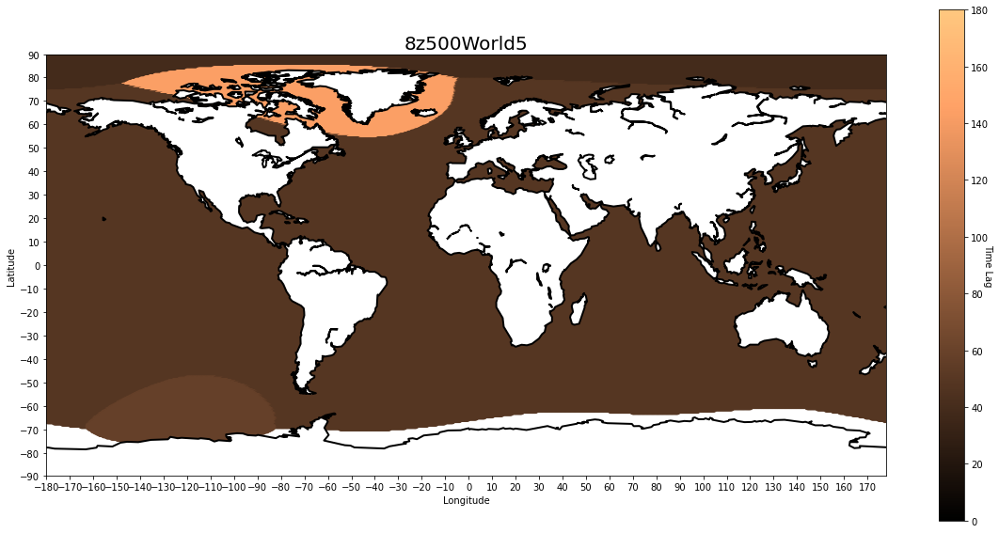

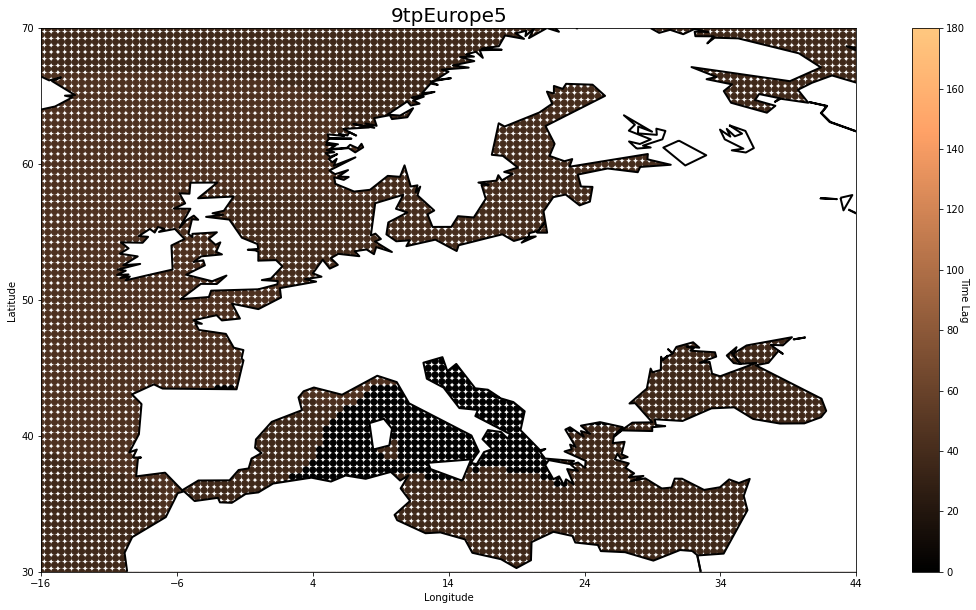

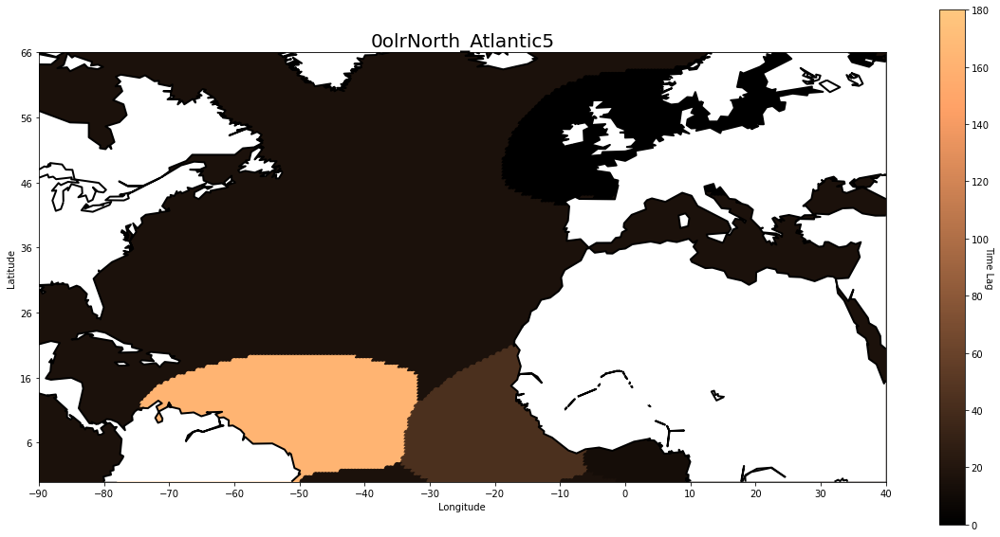

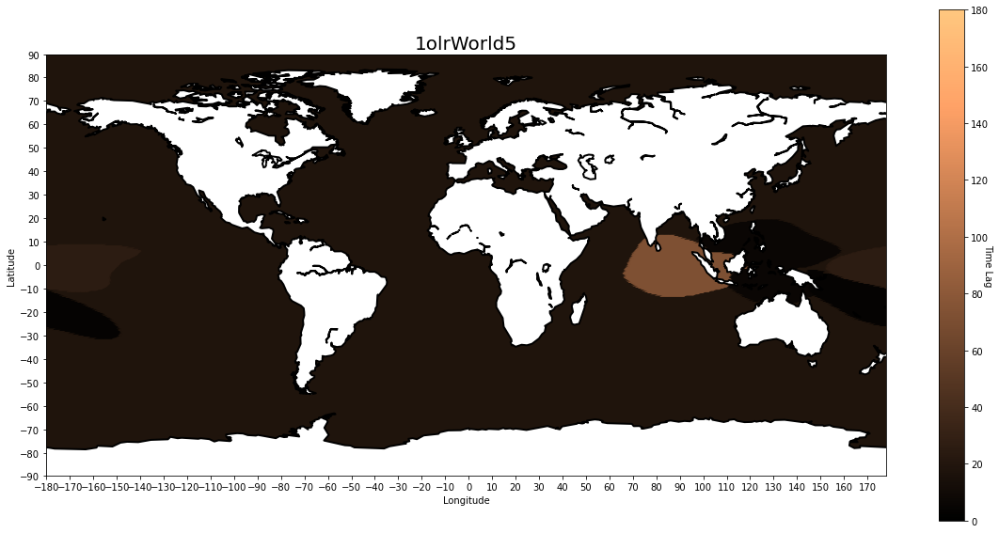

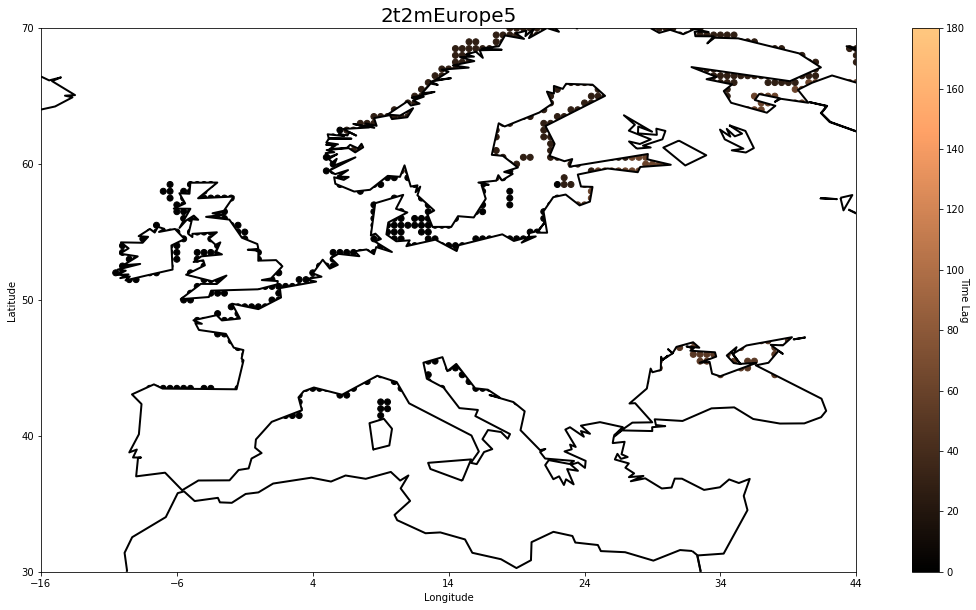

In [18]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        if feat_sel[h+i]==0:
            label_df['fin_seq'] = np.where(label_df['cluster'] == i, -1, label_df['fin_seq'])
        else:
            # print((final_sequence * feat_sel)[h+i])
            label_df['fin_seq'] = np.where(label_df['cluster'] == i, (final_sequence * feat_sel)[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels4sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    map.drawcoastlines(linewidth=2)
    map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='copper',vmin=0, vmax=180)

    cbar = plt.colorbar()
    cbar.set_label('Time Lag', rotation=270)
    plt.title(label_file[7:-4],fontsize=20)
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10))
    plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10))
    # Show the plot
    plt.show()

In [13]:
best100_index = sol_file_av.sort_values(by=['CV'],ascending=False).head(int(0.1*sol_file_av.shape[0])).index

arrays = []
for ind in best100_index:
    array = np.fromstring(sol_file_av.Sol[ind].replace('[', '').replace(']', '').replace('\n', ''), dtype=float, sep=' ')
    arrays.append(array)

 
0.3616 x + 0.3142


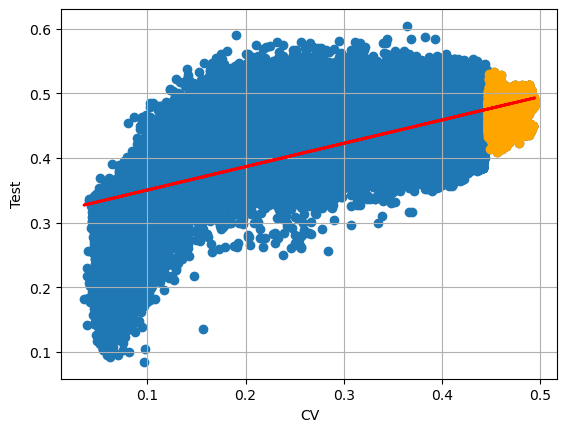

In [14]:
plt.scatter(sol_file_av['CV'],sol_file_av['Test'])
z = np.polyfit(sol_file_av['CV'], sol_file_av['Test'], 1)
p = np.poly1d(z)
# plt.scatter(sol_file_av.CV[sol_file_av.sort_values(by=['CV'],ascending=False).index[0]],sol_file_av.Test[sol_file_av.sort_values(by=['CV'],ascending=False).index[0]],color='black',marker='x',s=200,linewidths=3)
plt.scatter(sol_file_av.CV[best100_index],sol_file_av.Test[best100_index],color='orange')
#add trendline to plot
plt.plot(sol_file_av['CV'], p(sol_file_av['CV']), "r-", linewidth=2.0,)
plt.xlabel('CV')
plt.ylabel('Test')
plt.grid()
print(p)

In [15]:
n_rows = int(((sequence_length + final_sequence)*feat_sel).max())+5
n_cols = len(column_names)

board_100 = np.zeros((n_rows, n_cols))
discarded = np.zeros((1, n_cols))

for array in arrays:
    final_sequence = array[len(column_names):2*len(column_names)]
    sequence_length = array[:len(column_names)]
    feat_sel = array[2*len(column_names):]
    column_names = pred_dataframe_opt.columns.tolist()

    for i in range(n_cols):
        start_index = int(final_sequence[i])
        end_index = int(final_sequence[i]) + int(sequence_length[i])
        

        if feat_sel[i]==0:
            discarded[0,i] += 1
        else:
            board_100[start_index:end_index, i] += 1
    
board_100[0,:].shape

(61,)

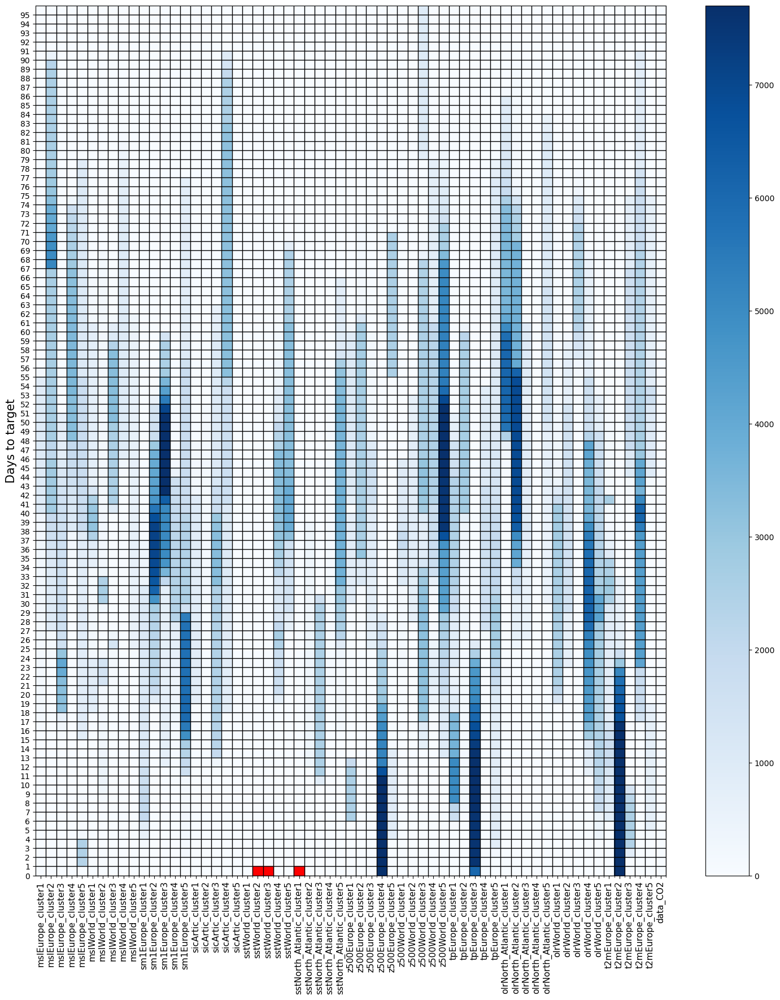

In [16]:
plt.figure(figsize=(18, 20))
plt.imshow(board_100, cmap='Blues', origin='lower', aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90, fontsize=11)
plt.yticks(np.arange(board_100.shape[0]) - 0.5, np.arange(board_100.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)
plt.gca().xaxis.grid(which='minor', color='black', linewidth=1)
plt.gca().yaxis.grid(which='major', color='black', linewidth=1)
plt.ylabel('Days to target', fontsize=15)

for i in range(board_100.shape[1]):
    if np.sum(board_100[:, i]) == 0:
        rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
        plt.gca().add_patch(rect)
plt.colorbar()
plt.ylim(-0.5, np.nonzero(board_100.sum(axis=1))[0][-1]+0.5)
plt.show()

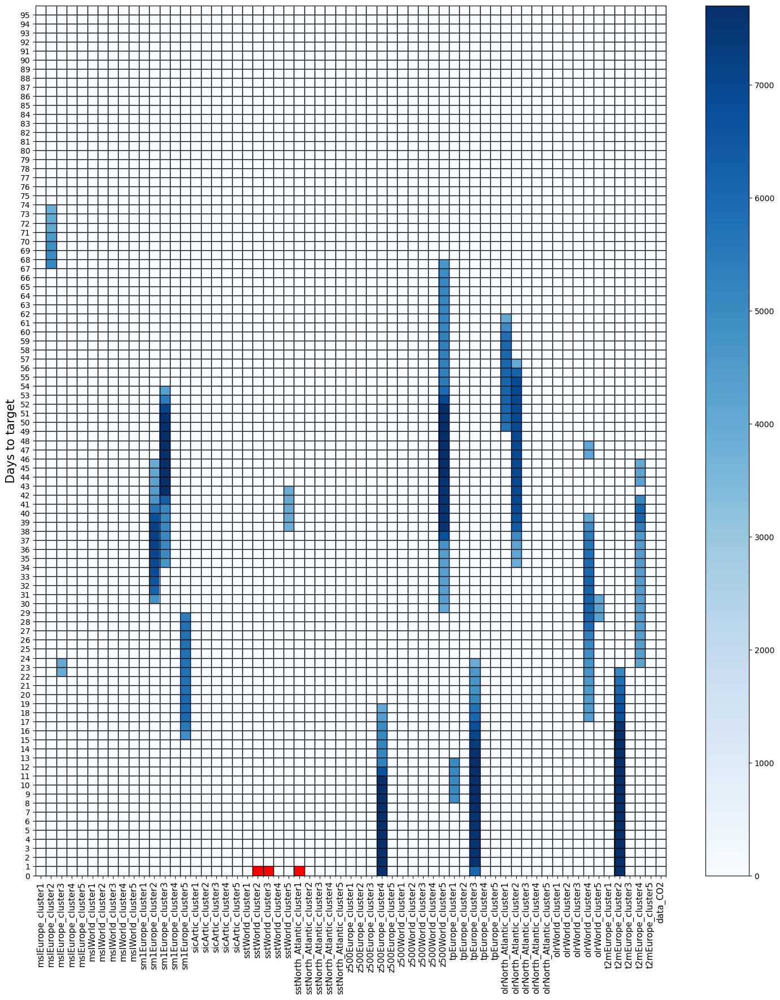

In [17]:

plt.figure(figsize=(18, 20))
plt.imshow(np.where(board_100/len(arrays) >0.5,board_100,0), cmap='Blues', origin='lower', aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90, fontsize=11)
plt.yticks(np.arange(board_100.shape[0]) - 0.5, np.arange(board_100.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)
plt.gca().xaxis.grid(which='minor', color='black', linewidth=1)
plt.gca().yaxis.grid(which='major', color='black', linewidth=1)
plt.ylabel('Days to target', fontsize=15)

for i in range(board_100.shape[1]):
    if np.sum(board_100[:, i]) == 0:
        rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
        plt.gca().add_patch(rect)
plt.colorbar()
plt.ylim(-0.5, np.nonzero(board_100.sum(axis=1))[0][-1]+0.5)
plt.show()

In [18]:
weighted_av = []
for i in range(board_100.shape[1]):
    if np.sum(board_100[:,i])==0:
        av=-1
    else:
        av=int(np.sum(board_100[:,i]*(1+np.arange(board_100.shape[0])))/np.sum(board_100[:,i]))-1
    weighted_av.append(av)
weighted_av

[42,
 61,
 29,
 56,
 43,
 40,
 32,
 49,
 61,
 42,
 17,
 35,
 42,
 33,
 32,
 31,
 40,
 32,
 61,
 46,
 29,
 -1,
 -1,
 37,
 49,
 -1,
 25,
 20,
 36,
 42,
 31,
 47,
 39,
 10,
 53,
 37,
 40,
 45,
 49,
 47,
 24,
 46,
 10,
 38,
 38,
 61,
 50,
 44,
 40,
 59,
 32,
 40,
 65,
 33,
 27,
 24,
 11,
 43,
 45,
 44,
 74]

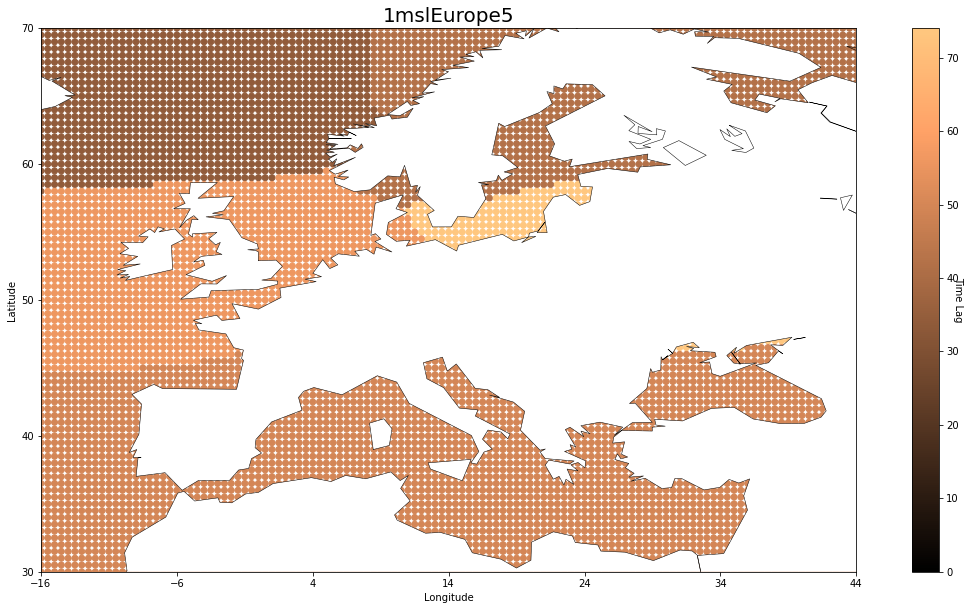

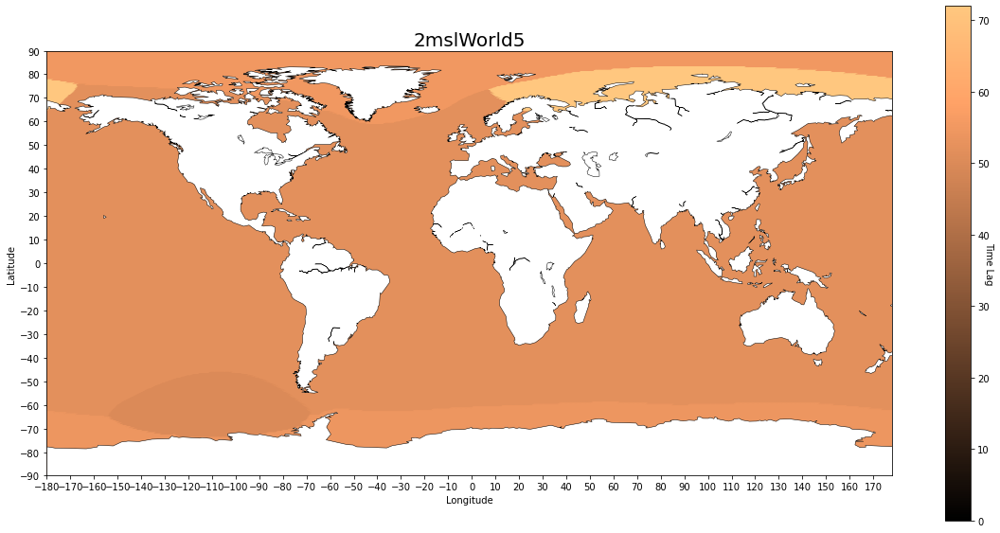

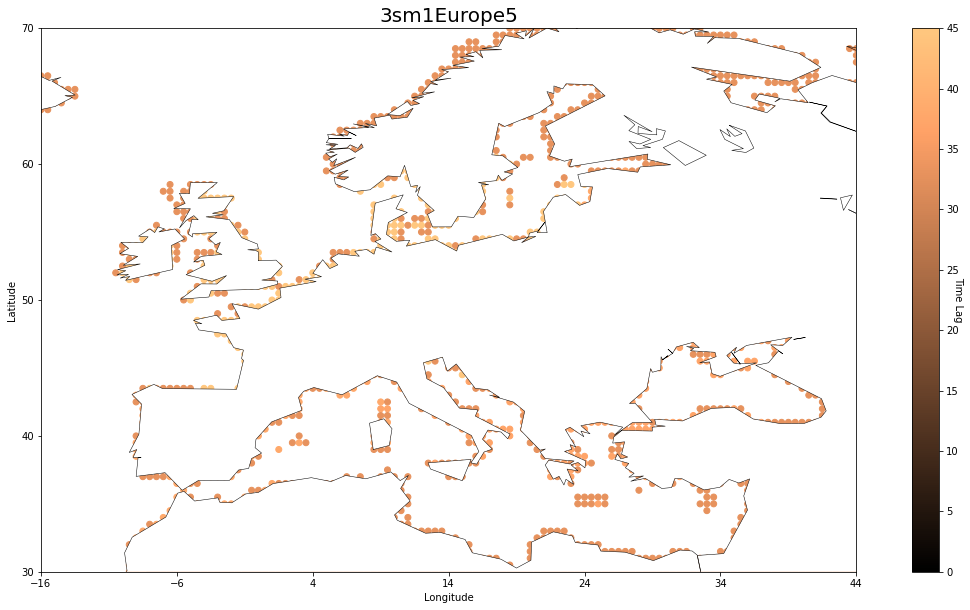

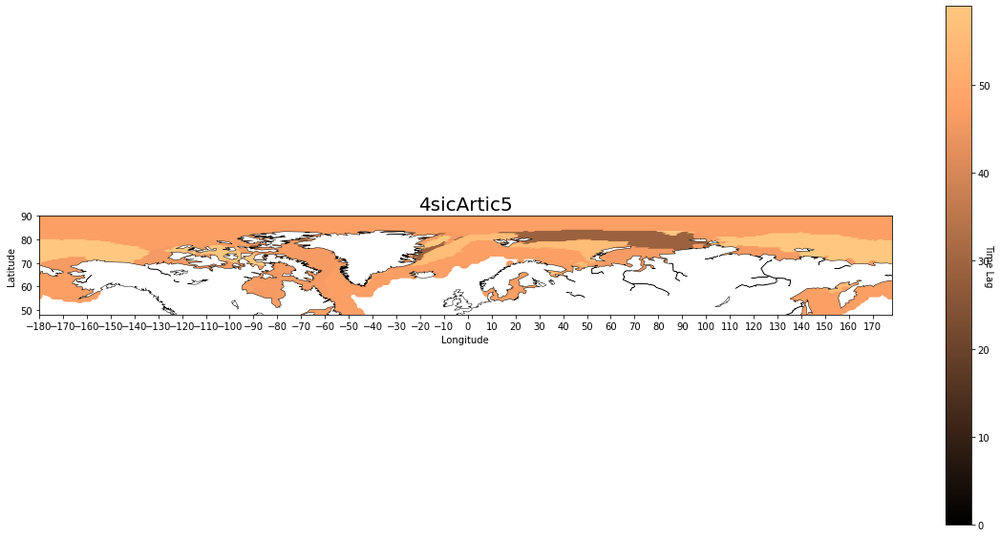

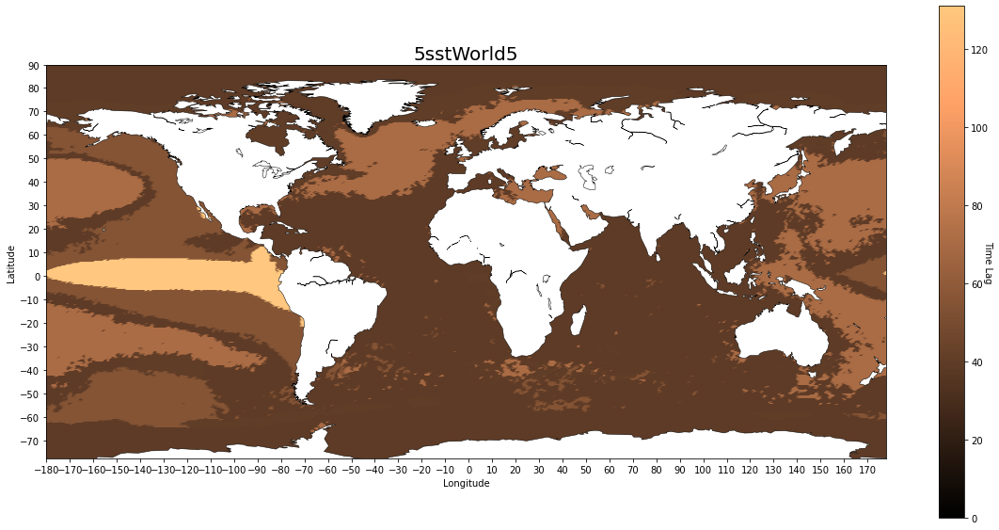

...

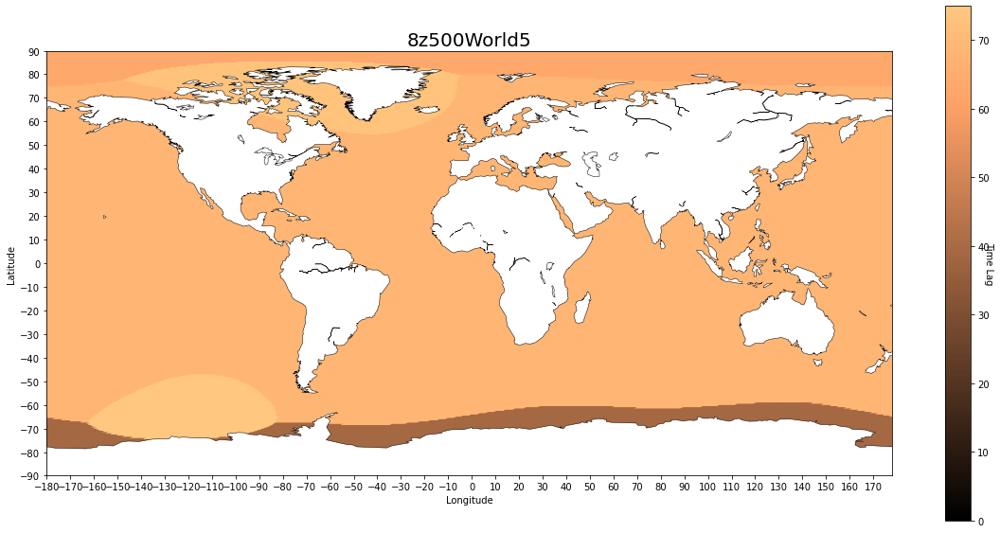

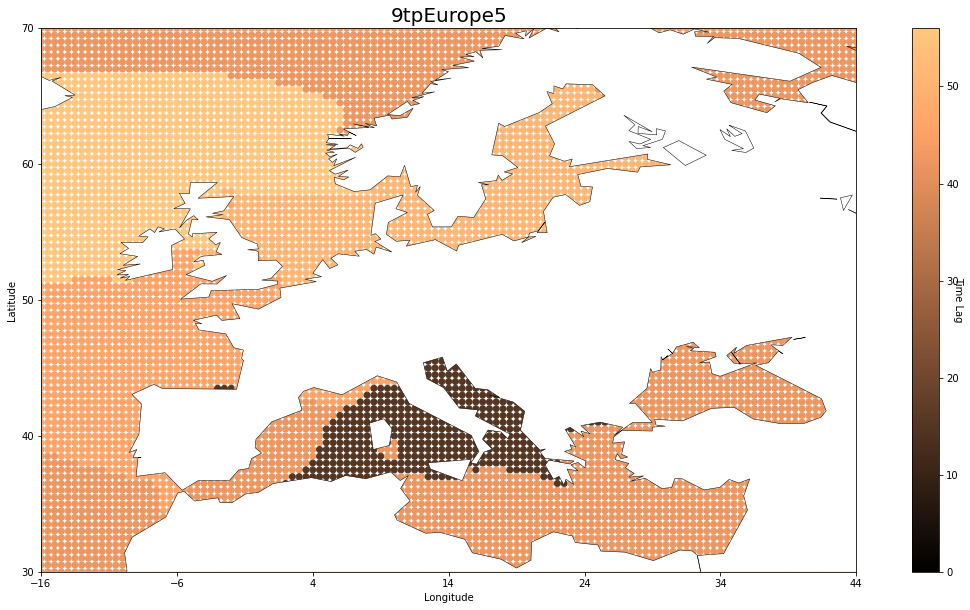

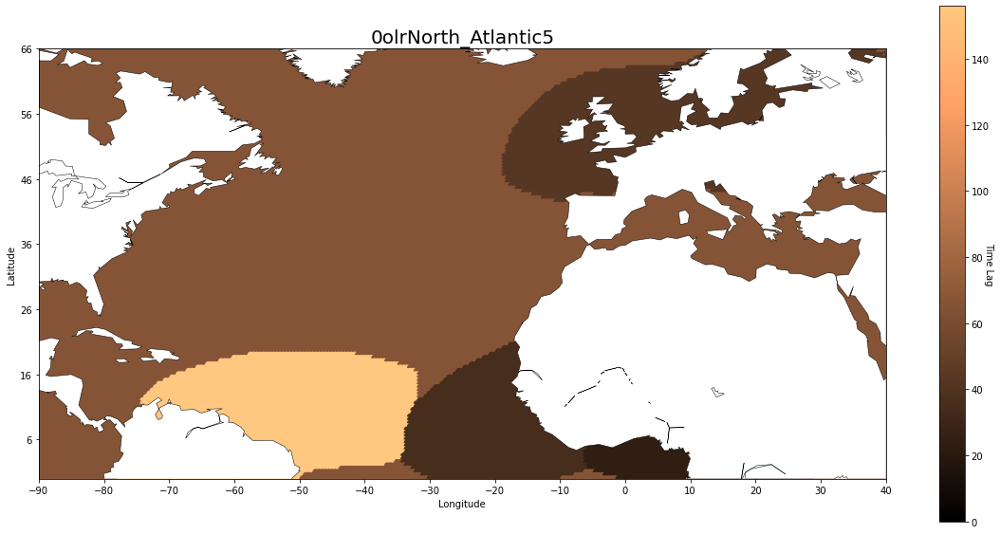

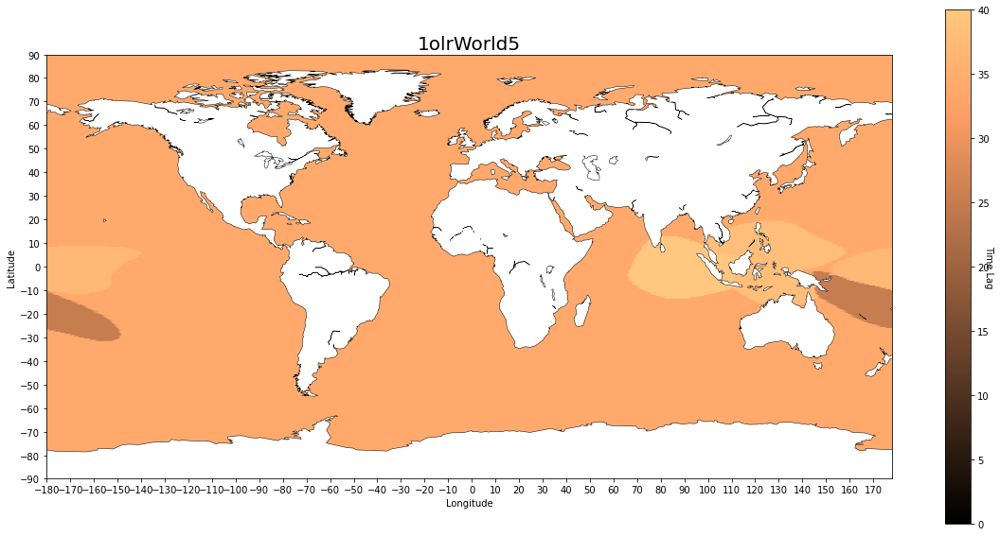

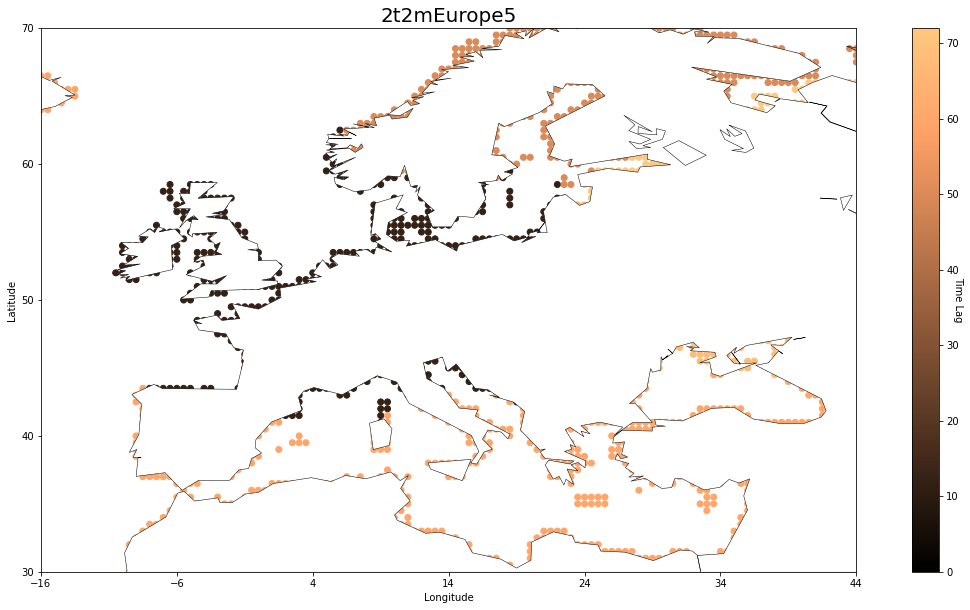

In [25]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        label_df['fin_seq'] = np.where(label_df['cluster'] == i, weighted_av[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels4sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    map.drawcoastlines(linewidth=0.5)
    map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='copper',vmin=0, vmax=label_df['fin_seq'].max())

    cbar = plt.colorbar()
    cbar.set_label('Time Lag', rotation=270)
    plt.title(label_file[7:-4],fontsize=20)
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10))
    plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10))
    # Show the plot
    plt.show()

In [19]:
sequence_lengths = []

for i in range(board_100.shape[1]):
    col = board_100[:, i]  # Get the current column
    consecutive_count = 0  # Initialize consecutive count
    max_consecutive_count = 0  # Initialize maximum consecutive count

    for value in col:
        if value/len(arrays) > 0.25:
            consecutive_count += 1
        else:
            consecutive_count = 0  # Reset count if the value is 0

        # Update maximum consecutive count
        max_consecutive_count = max(max_consecutive_count, consecutive_count)

    sequence_lengths.append(max_consecutive_count)

# Now, 'sequence_lengths' contains the sequence lengths for each column
print(sequence_lengths)

[0, 50, 7, 26, 3, 5, 3, 18, 0, 0, 3, 27, 27, 13, 16, 0, 0, 26, 35, 0, 0, 0, 0, 17, 32, 0, 0, 19, 0, 31, 6, 26, 0, 25, 16, 0, 0, 28, 19, 49, 13, 20, 25, 0, 15, 27, 40, 0, 0, 0, 21, 0, 12, 34, 34, 5, 24, 6, 47, 0, 0]


In [20]:
first_max=[]
for i in range(board_100.shape[1]):
    if np.sum(board_100[:,i])==0:
        av=-1
    else:
        av=board_100.argmax(axis=0)[i]
    first_max.append(av)
first_max

[43,
 67,
 23,
 54,
 3,
 38,
 31,
 50,
 49,
 36,
 7,
 37,
 43,
 30,
 17,
 38,
 38,
 34,
 56,
 44,
 29,
 -1,
 -1,
 44,
 41,
 -1,
 13,
 13,
 32,
 34,
 7,
 35,
 45,
 1,
 57,
 37,
 44,
 28,
 42,
 48,
 11,
 42,
 7,
 40,
 28,
 52,
 47,
 38,
 33,
 50,
 40,
 49,
 64,
 28,
 28,
 31,
 0,
 5,
 39,
 52,
 62]

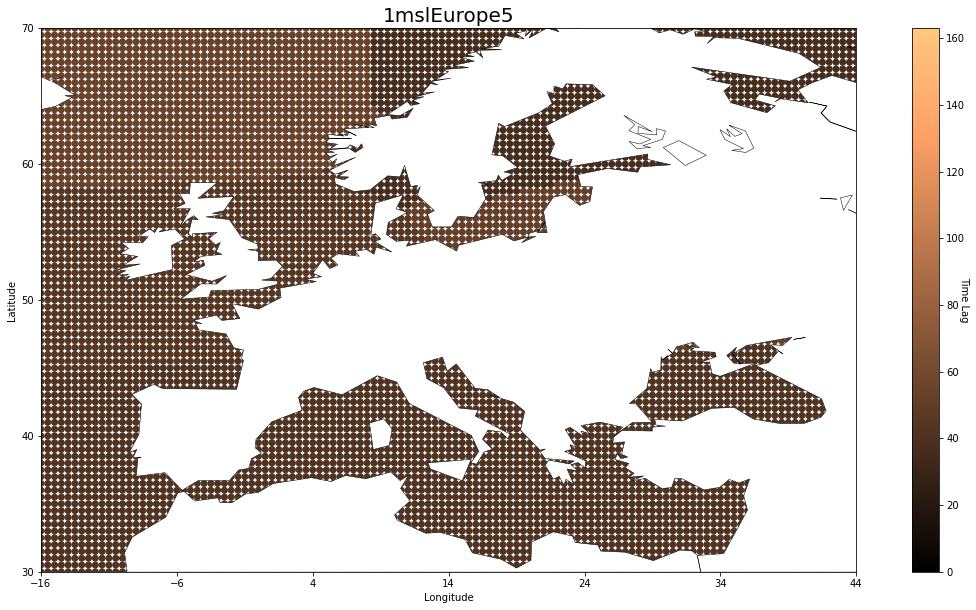

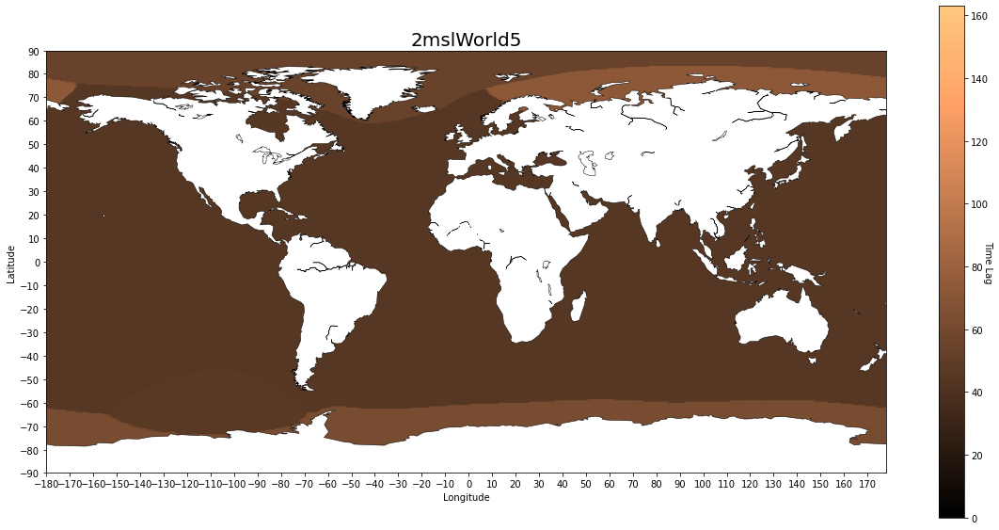

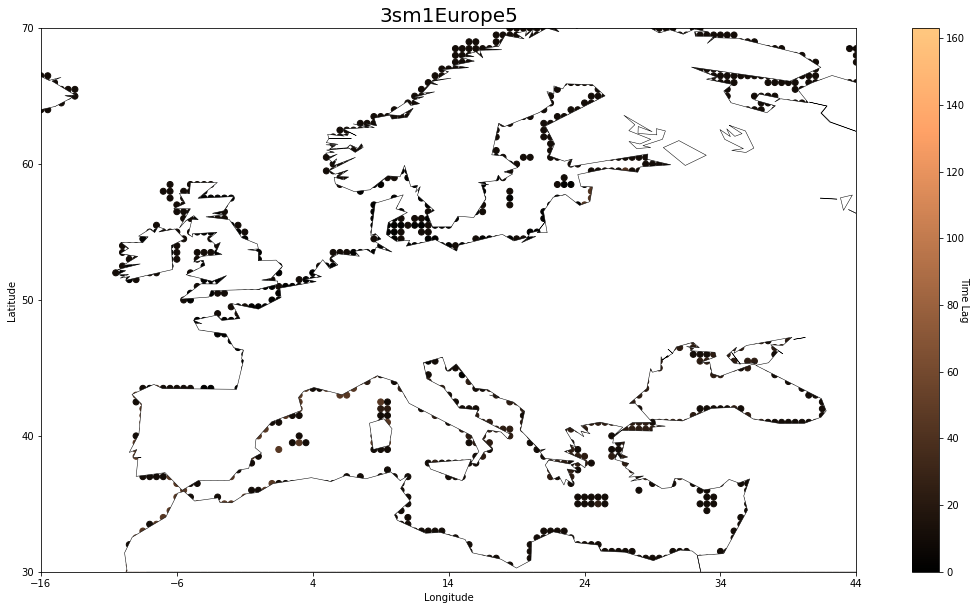

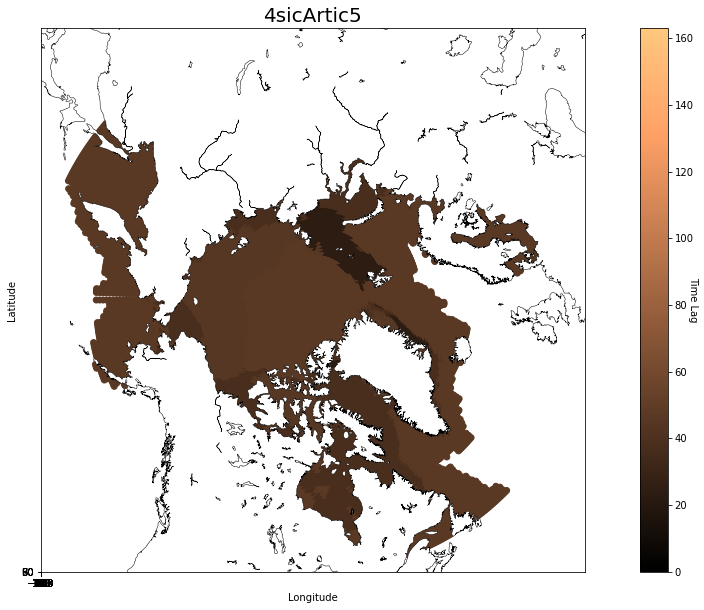

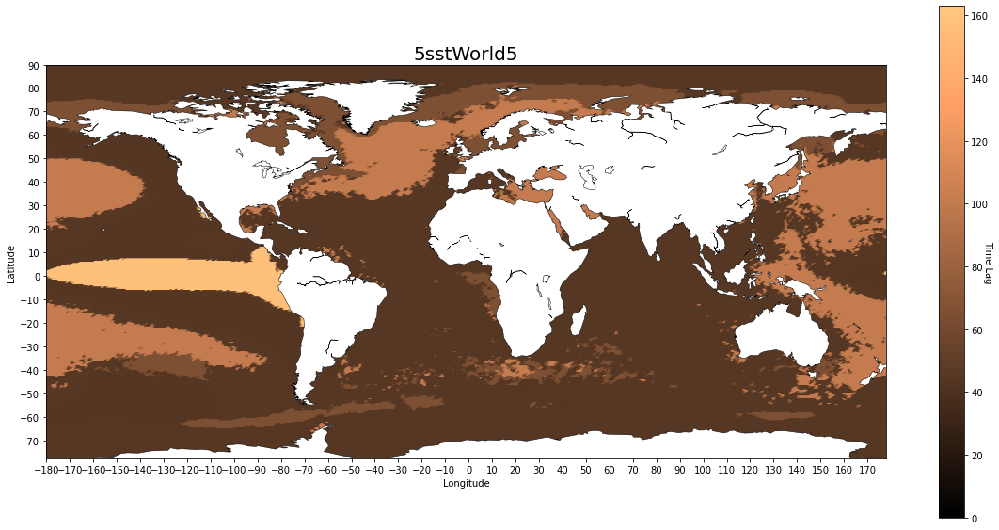

...

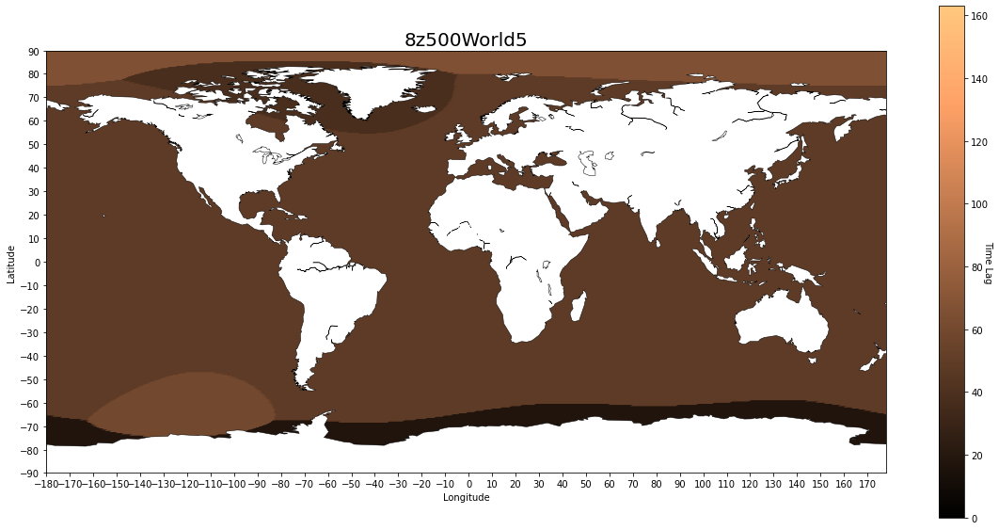

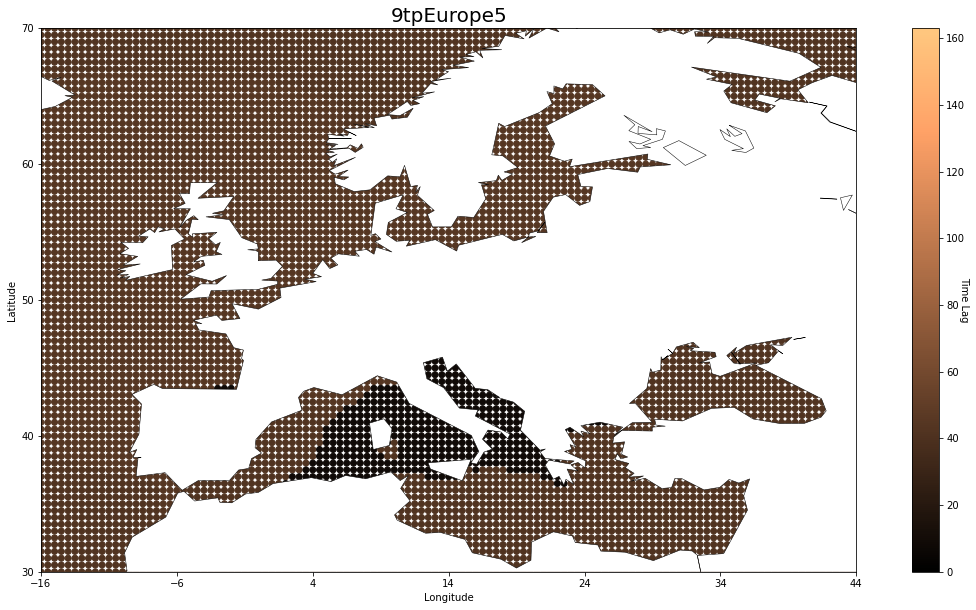

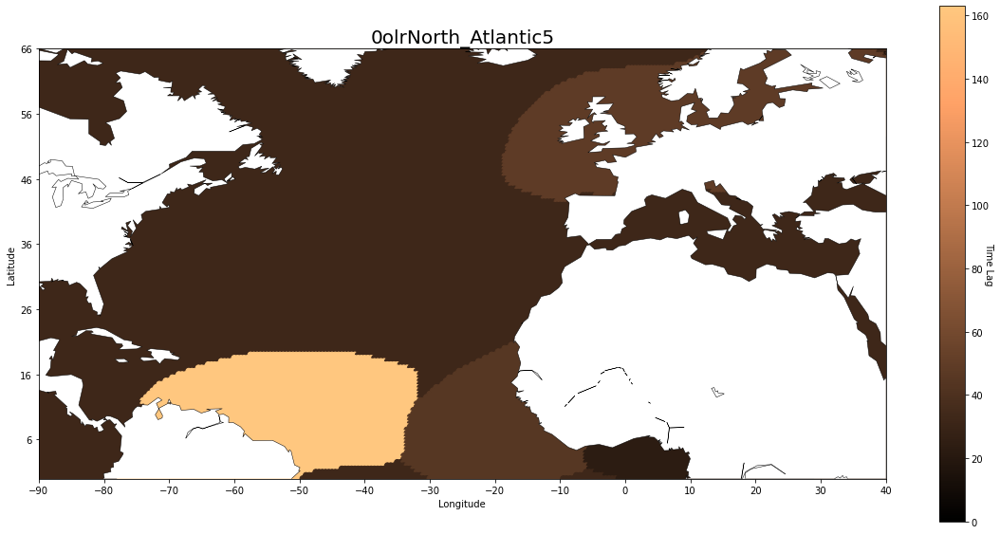

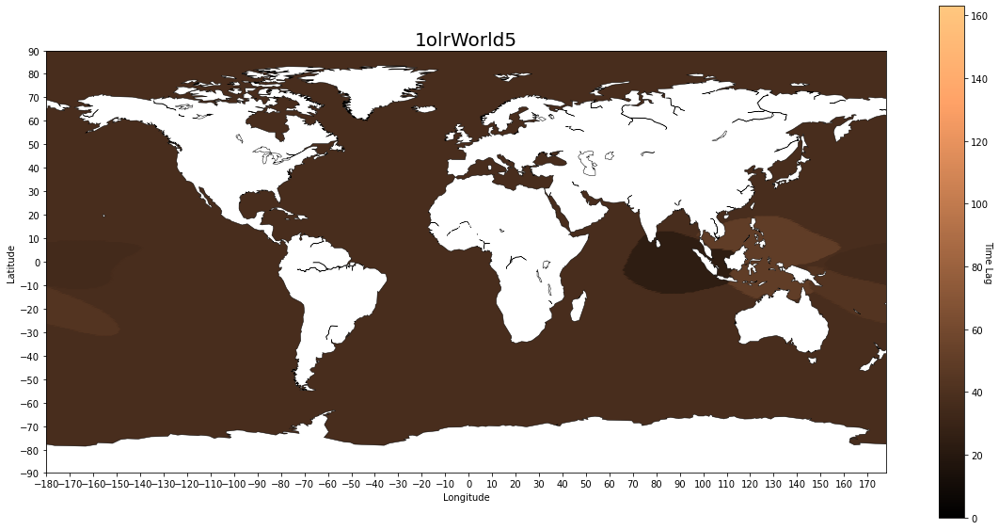

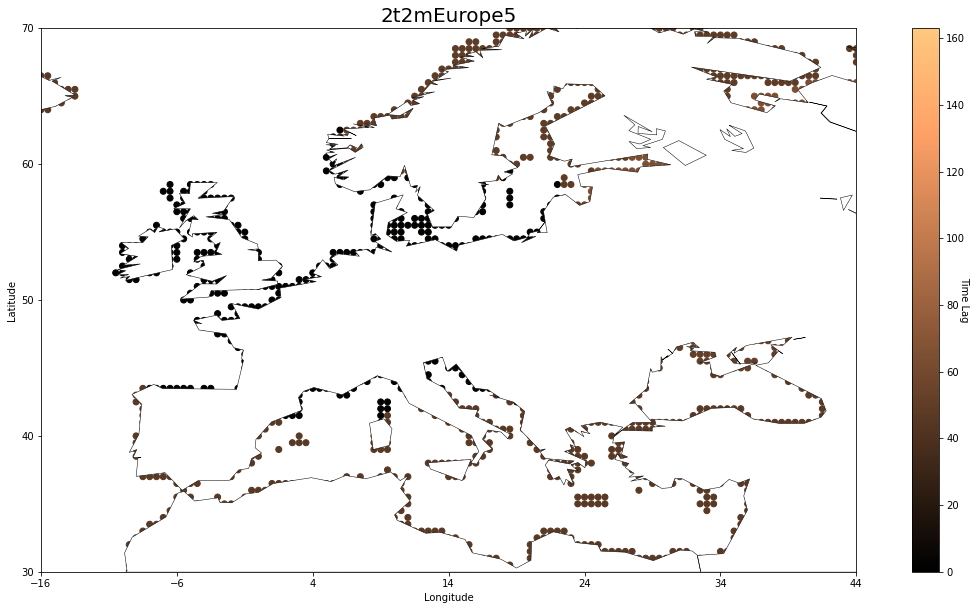

In [28]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        label_df['fin_seq'] = np.where(label_df['cluster'] == i, first_max[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels04sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    map.drawcoastlines(linewidth=0.5)
    map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='copper',vmin=0, vmax=np.array(first_max).max())

    cbar = plt.colorbar()
    cbar.set_label('Time Lag', rotation=270)
    plt.title(label_file[7:-4],fontsize=20)
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10))
    plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10))
    # Show the plot
    plt.show()

In [21]:
av_max=[]
for i in range(board_100.shape[1]):
    if np.sum(board_100[:,i])==0:
        av=-1
    else:
        av=[h for h, x in enumerate(board_100[:,i]) if x == max(board_100[:,i])]
    av_max.append(np.array(av).mean())
av_max


[46.5,
 67.0,
 23.0,
 54.0,
 3.0,
 38.0,
 31.0,
 50.0,
 57.5,
 36.0,
 7.0,
 37.0,
 43.5,
 30.0,
 18.0,
 39.0,
 42.5,
 34.0,
 56.5,
 48.0,
 36.0,
 -1.0,
 -1.0,
 44.0,
 41.0,
 -1.0,
 25.5,
 19.5,
 40.5,
 37.5,
 9.0,
 35.0,
 45.0,
 5.0,
 58.0,
 37.0,
 45.5,
 28.5,
 43.5,
 49.0,
 11.5,
 42.0,
 8.5,
 40.0,
 28.0,
 52.5,
 48.0,
 38.0,
 41.5,
 56.0,
 40.0,
 49.0,
 64.5,
 28.0,
 28.0,
 31.0,
 4.5,
 5.5,
 39.5,
 52.0,
 74.5]

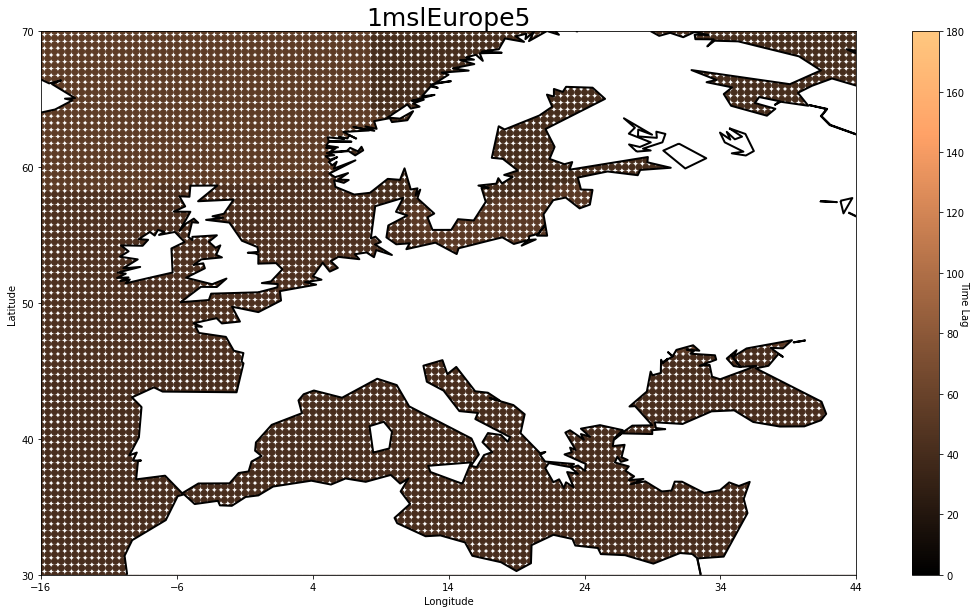

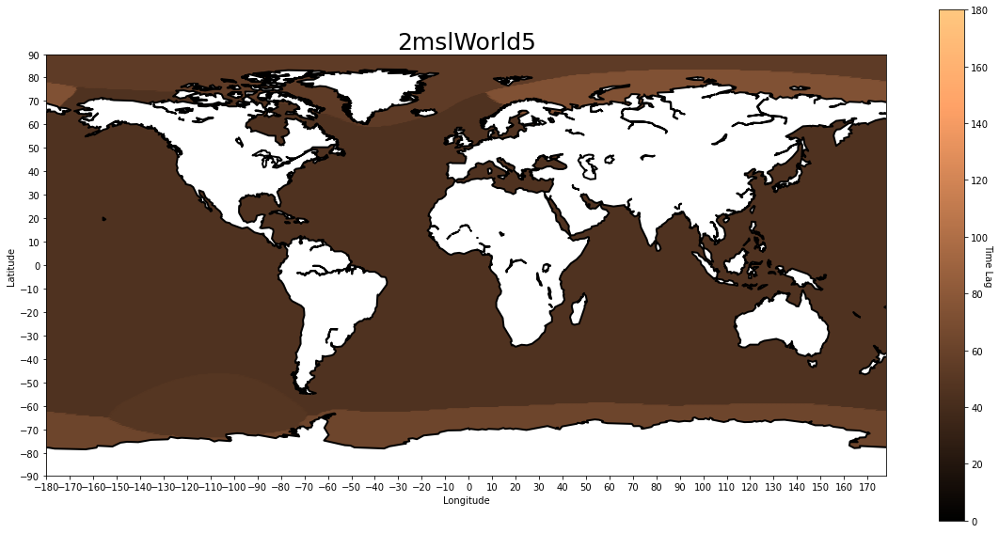

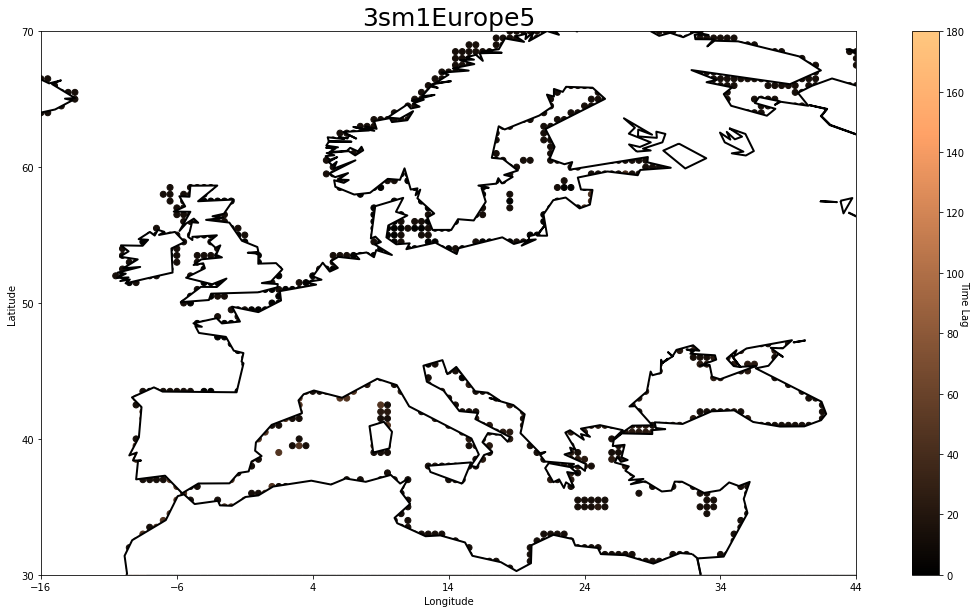

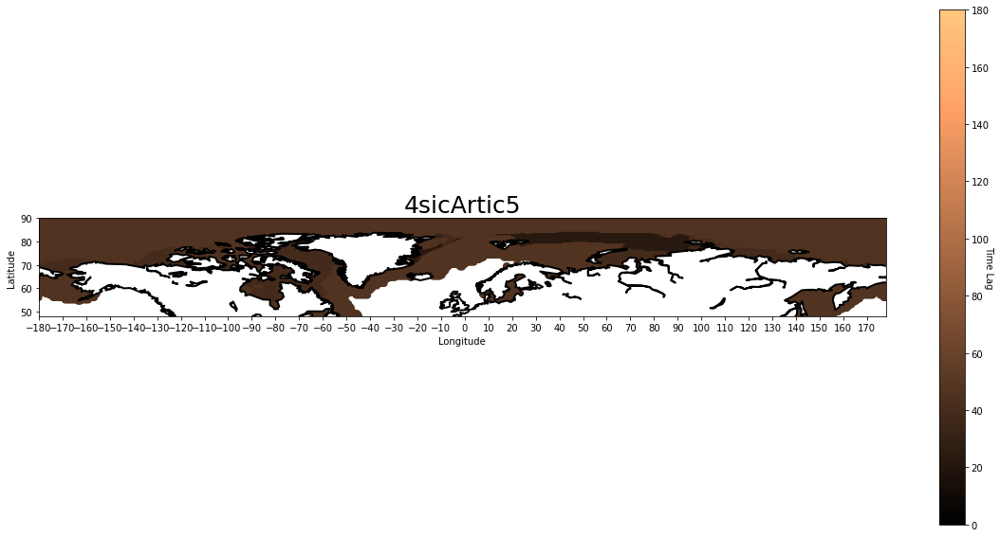

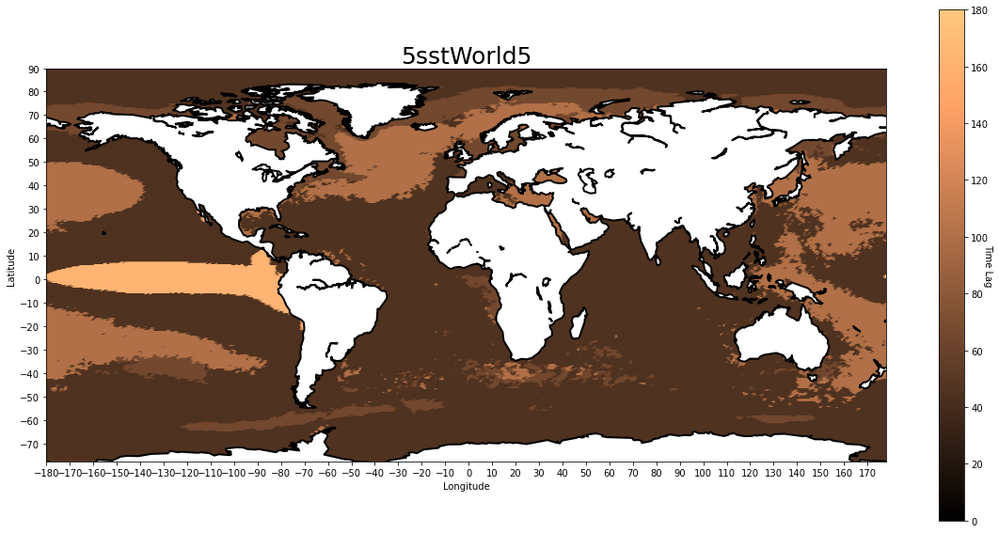

...

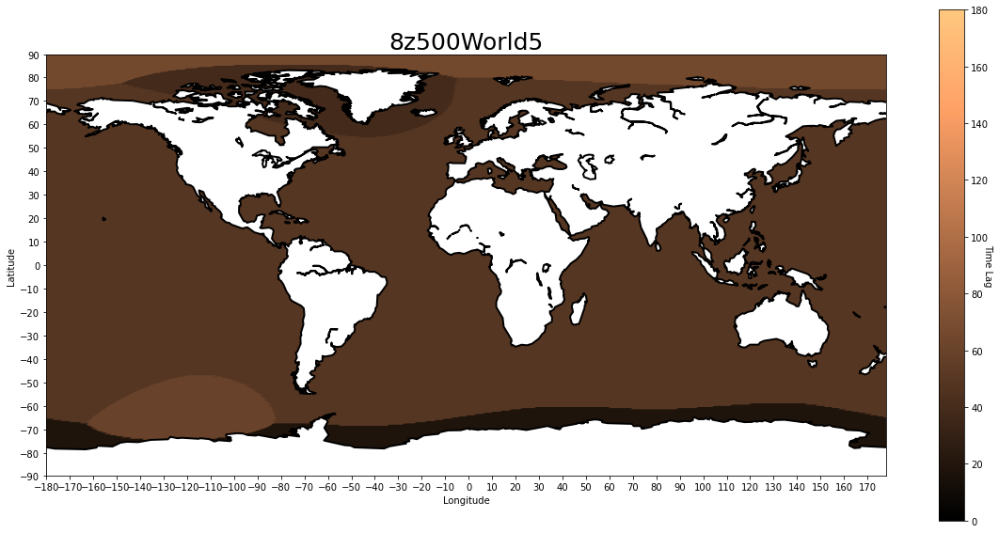

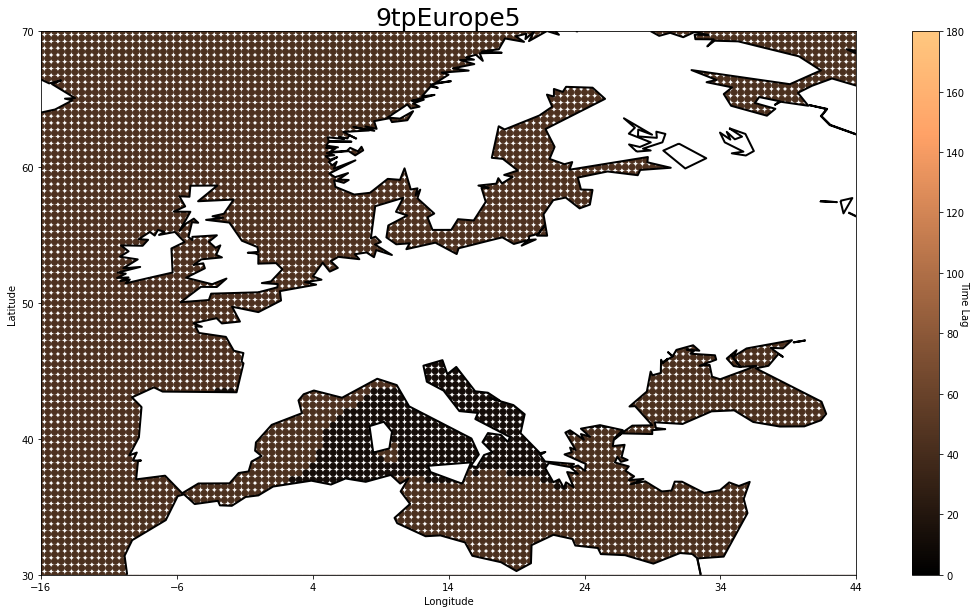

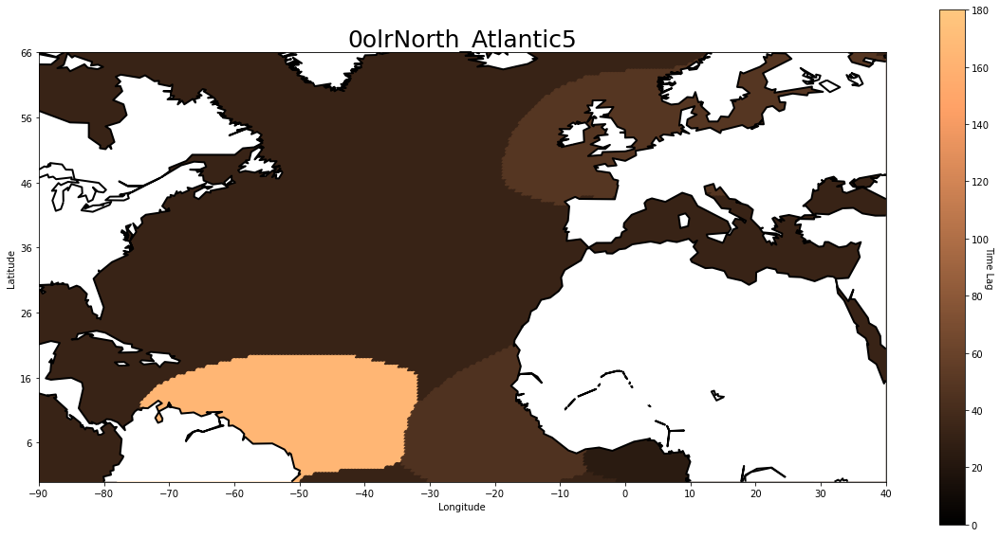

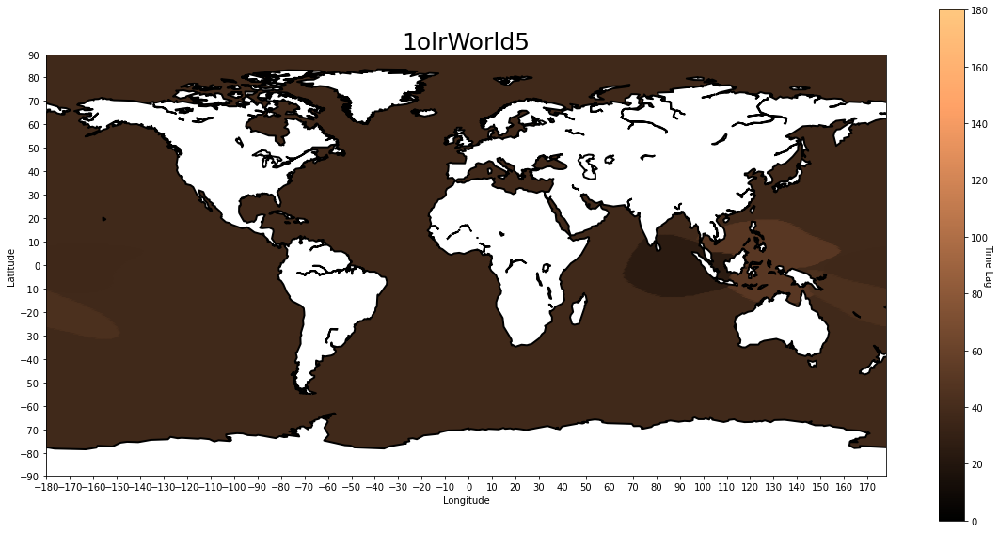

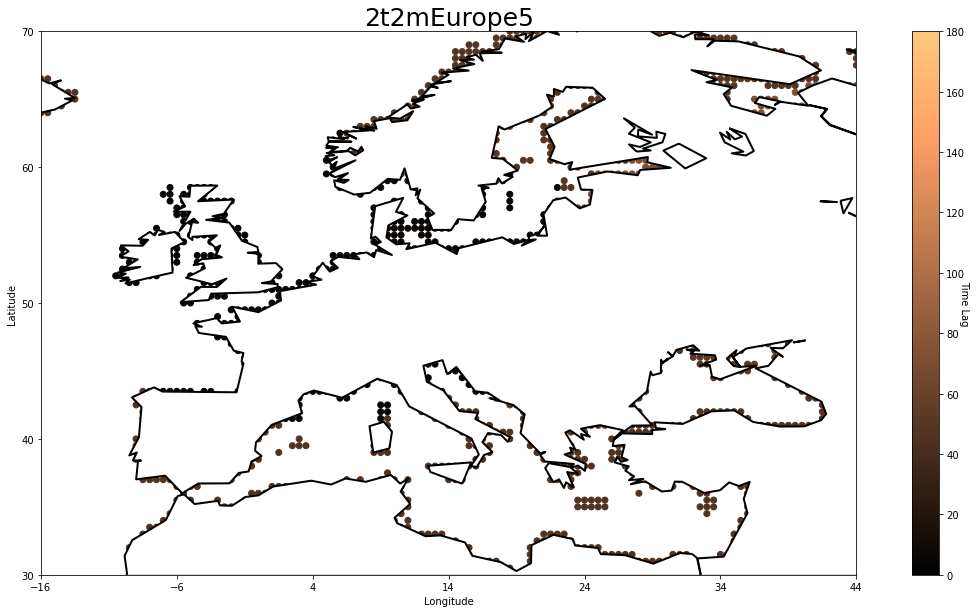

In [30]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        label_df['fin_seq'] = np.where(label_df['cluster'] == i, av_max[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels4sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    
    map.drawcoastlines(linewidth=2)
    map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='copper',vmin=0, vmax=180)

    cbar = plt.colorbar()
    cbar.set_label('Time Lag', rotation=270)
    plt.title(label_file[7:-4],fontsize=25)
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10))
    plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10))
    # Show the plot
    plt.show()

(-0.5, 61.5)

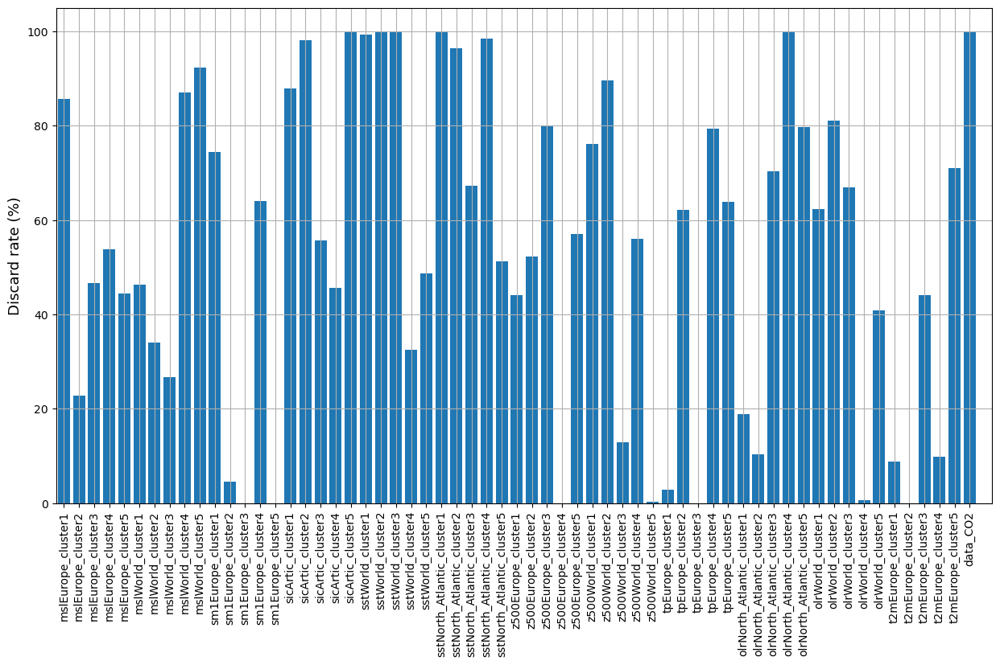

In [22]:
plt.figure(figsize=(15, 8))
plt.bar(pred_dataframe_opt.columns,discarded[0]*100/len(arrays))
plt.xticks(rotation = 90,fontsize=10)
plt.grid()
# plt.ylim(0,1)
plt.ylabel('Discard rate (%)',fontsize=13)
plt.yticks(fontsize=10)
plt.xlim(-0.5,pred_dataframe_opt.shape[1]+0.5)

In [23]:
df_discarded = pd.DataFrame(discarded[0]*100/len(arrays),index=pred_dataframe_opt.columns,columns=['Discard rate (%)'])
df_discarded['Weighted average (days to target)'] = weighted_av
df_discarded['First maximum (days to target)'] = first_max
df_discarded['Sequence length (consecutive days > 25%)'] = sequence_lengths
df_discarded.sort_values(by=['Discard rate (%)'],ascending=True,inplace=True)

df_discarded

,Discard rate (%),Weighted average (days to target),First maximum (days to target),Sequence length (consecutive days > 25%)
t2mEurope_cluster2,0.000000,11,0,24
z500Europe_cluster4,0.000000,10,1,25
tpEurope_cluster3,0.012984,10,7,25
sm1Europe_cluster5,0.025967,32,17,16
sm1Europe_cluster3,0.025967,42,43,27
...,...,...,...,...
olrNorth_Atlantic_cluster4,99.974033,40,33,0
data_CO2,99.987016,74,62,0
sstNorth_Atlantic_cluster1,100.000000,-1,-1,0
sstWorld_cluster3,100.000000,-1,-1,0


In [33]:
df_discarded.tail(10)

,Discard rate (%),Weighted average (days to target),First maximum (days to target),Sequence length (consecutive days > 25%)
z500World_cluster1,47.876903,68,49,47
mslWorld_cluster5,51.962256,52,45,35
olrNorth_Atlantic_cluster1,53.860176,156,163,23
t2mEurope_cluster4,54.042462,60,46,28
sstWorld_cluster2,55.436414,39,45,11
sstNorth_Atlantic_cluster1,59.103581,30,52,0
sstWorld_cluster1,65.933948,71,101,0
sicArtic_cluster1,70.802059,46,38,3
sstNorth_Atlantic_cluster4,74.780184,38,41,0
sicArtic_cluster5,82.253914,56,47,0


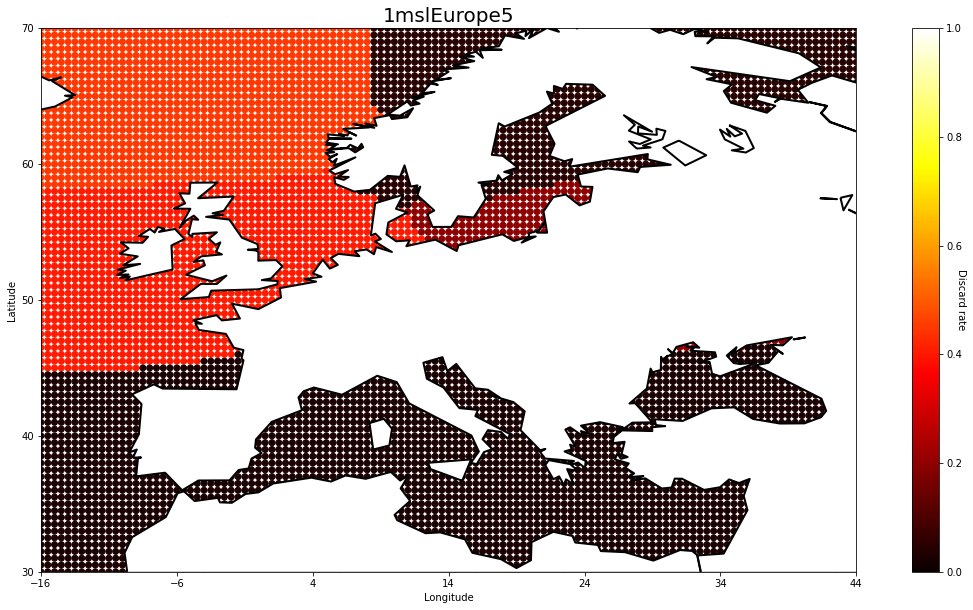

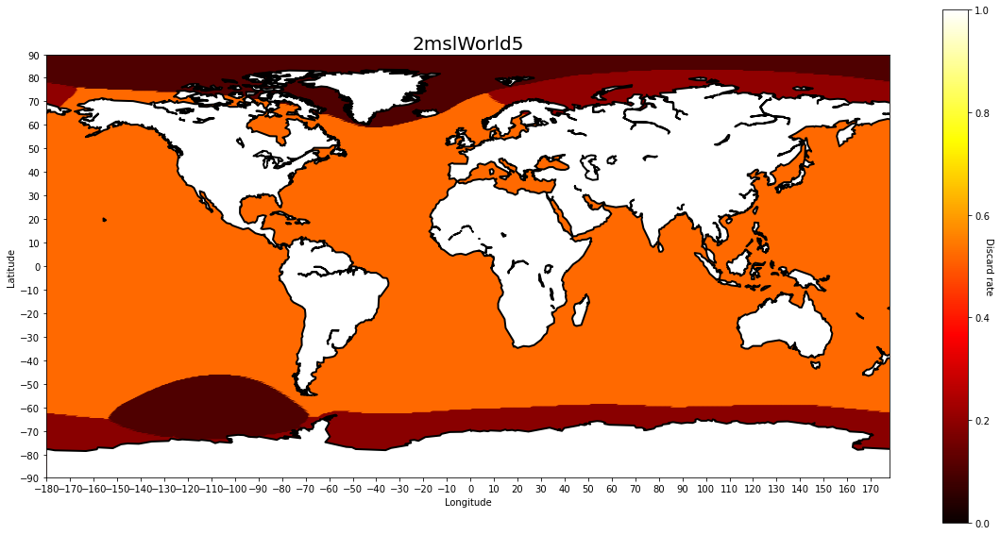

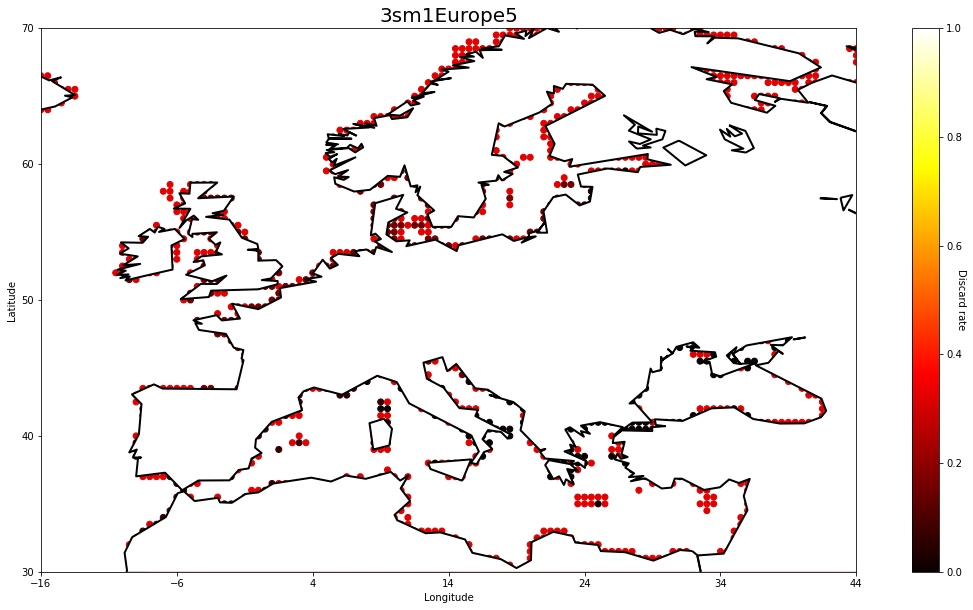

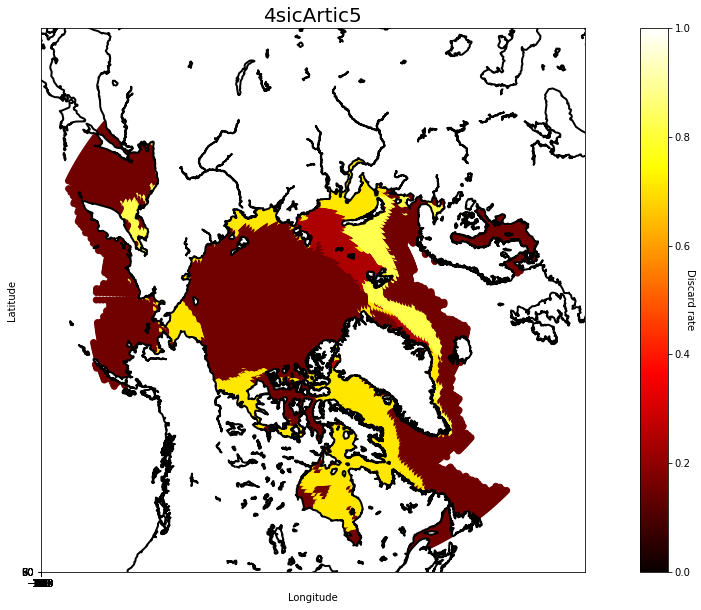

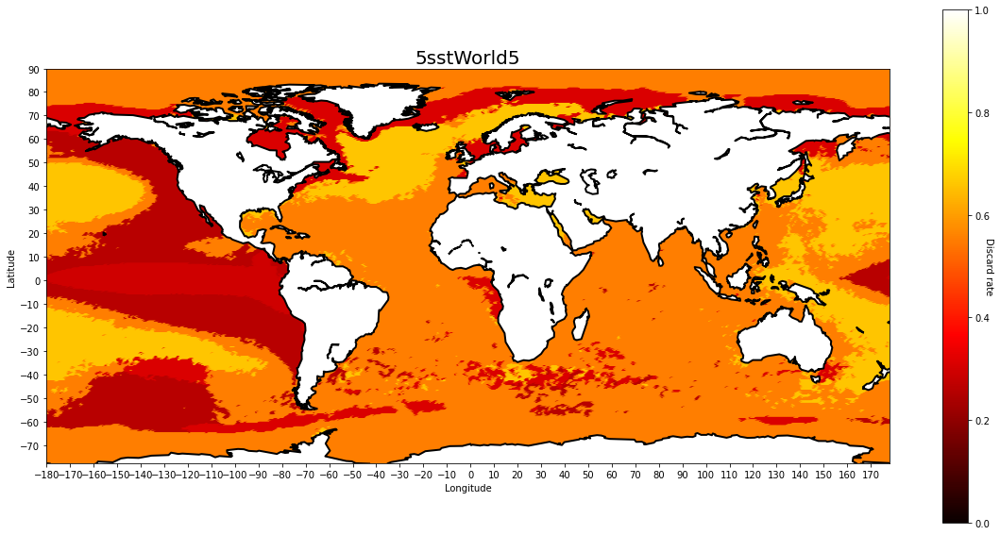

...

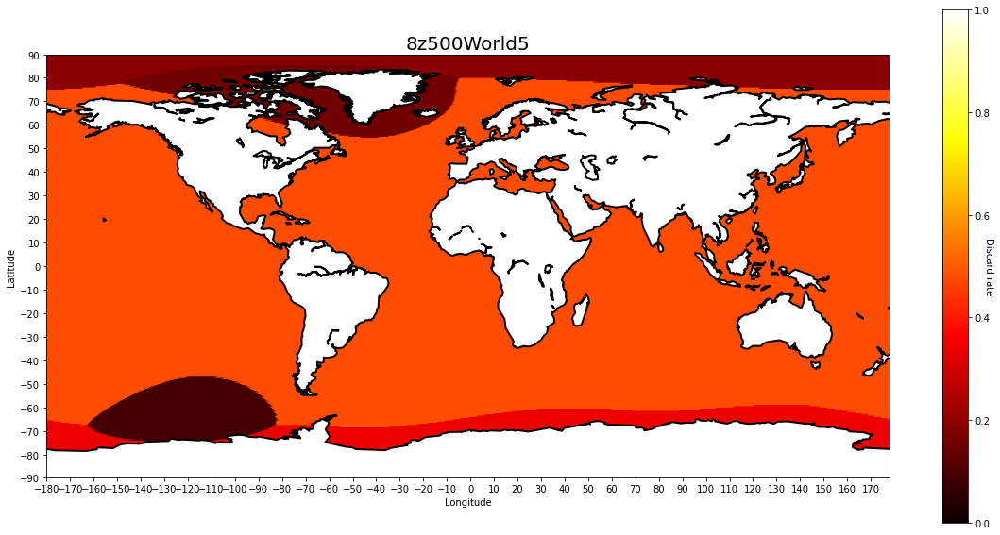

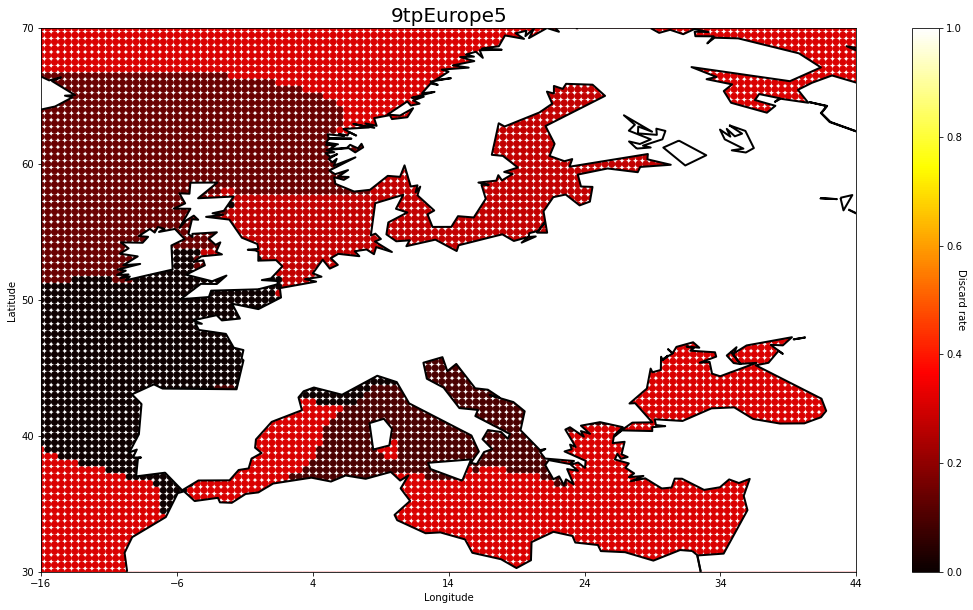

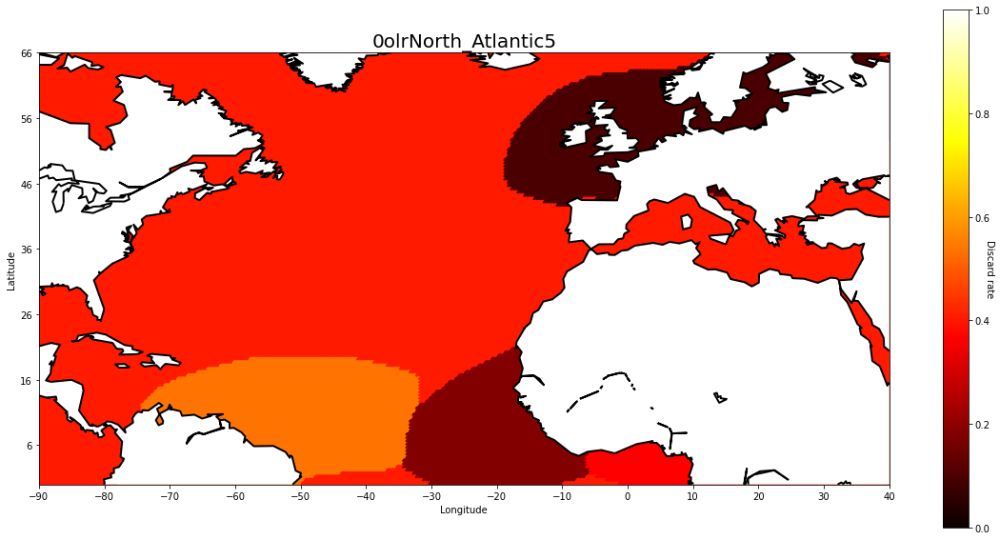

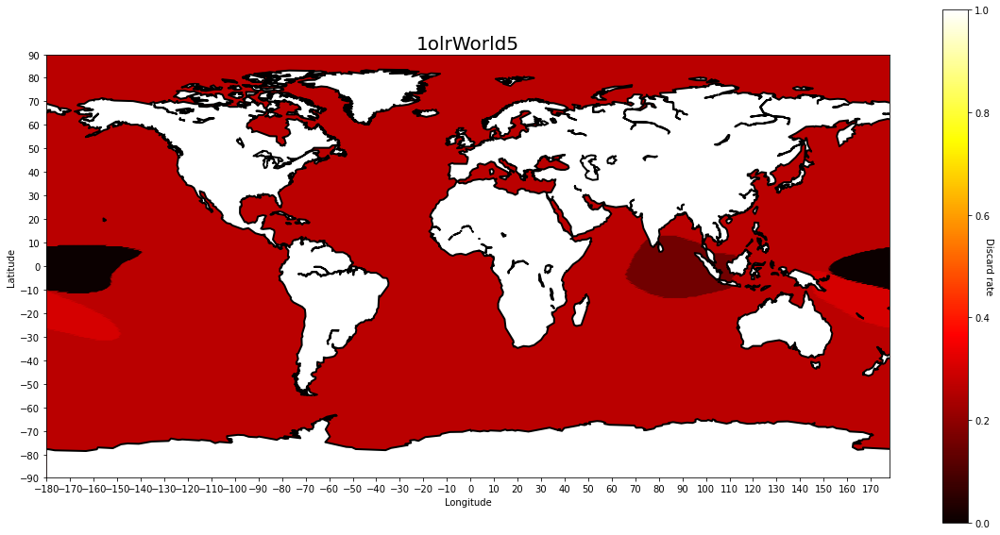

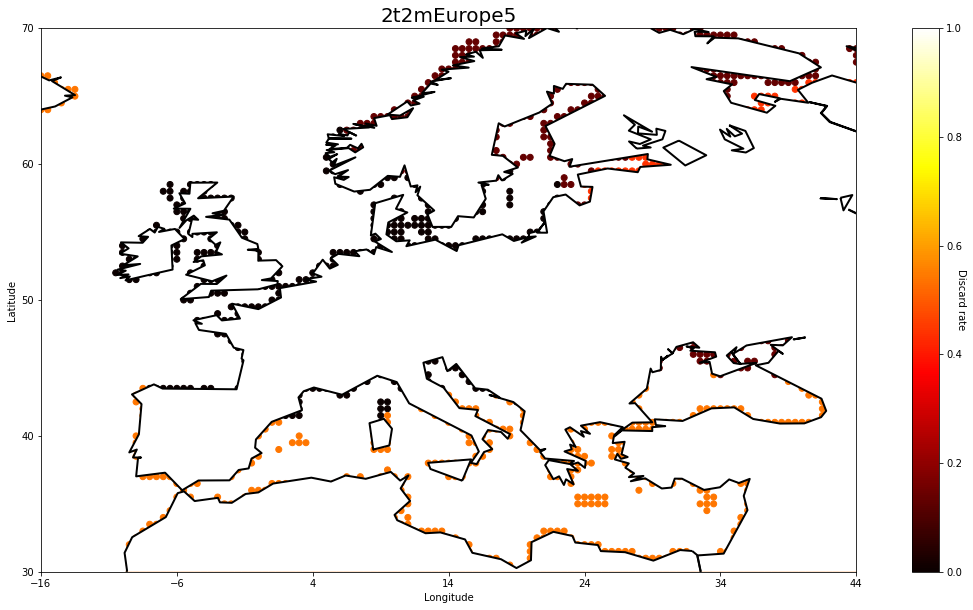

In [34]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        
        # if (discarded[0]/len(arrays))[h+i]==0:
        #     label_df['fin_seq'] = np.where(label_df['cluster'] == i, -1, label_df['fin_seq'])
        # else:
        label_df['fin_seq'] = np.where(label_df['cluster'] == i, (discarded[0]/len(arrays))[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels04sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    
    map.drawcoastlines(linewidth=2)
    map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='hot',vmin=0, vmax=1)

    cbar = plt.colorbar()
    cbar.set_label('Discard rate', rotation=270)
    plt.title(label_file[7:-4],fontsize=20)
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10))
    plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10))
    # Show the plot
    plt.show()

### ML

In [25]:
pred_dataframe = pd.read_csv('./Predictors/'+experiment+'/Predictors_dataset.csv', index_col=0)
pred_dataframe.index = pd.to_datetime(pred_dataframe.index)
target_dataset = pd.read_csv('./Predictors/'+experiment+'/target.csv', index_col=0)
target_dataset.index = pd.to_datetime(target_dataset.index)

first_train = 1951
last_train = 2010


train_indices = (target_dataset.index.year >=first_train) & (target_dataset.index.year <=last_train)
test_indices = (target_dataset.index.year >last_train)

In [27]:
# train_indices = train_indices[:,0]
# test_indices = test_indices[:,0]

In [26]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_best.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

#### Best Solution

In [112]:
train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

In [113]:
X_train = np.array(X_train)[:,board_best.T.reshape(1,-1)[0].astype(bool)]
X_test = np.array(X_test)[:,board_best.T.reshape(1,-1)[0].astype(bool)]

In [114]:
from functions import forecast_plots
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error,precision_score, accuracy_score, confusion_matrix, classification_report, recall_score, f1_score
    

ModuleNotFoundError: No module named 'functions'

In [ ]:
def plotter(x,y,array1, array2, method):
    fig,ax=plt.subplots(figsize=(8,7))
    plt.title("{0}".format(method))

    plt.pcolormesh(y,x,array2,cmap='binary')
    for i in range(x.size):
        for j in range(y.size-1):
            if array1[i,j]==1:
                #print (j,i)
                plt.plot(y[j]+0.5,x[i],'ro')
    plt.xticks(range(2011,2023,1))
    plt.ylim([0,123])
    ticks=np.array([0,31,31+30,31+30+31])+15
    plt.yticks(ticks,["May","Jun","Jul","Aug"],rotation=45)
    ax.yaxis.set_minor_locator(FixedLocator(ticks-15))
    ax.xaxis.set_minor_locator(FixedLocator(np.arange(2011,2023,1)+0.5))
    ax.tick_params(which='minor',width=1)

    plt.xlim([2010.5,2022.5])
    plt.grid(axis='y',which='minor')
    plt.grid(axis='x',which='minor')
    plt.show()

x=np.arange(123)
y=np.arange(2010.5,2023.5,1)

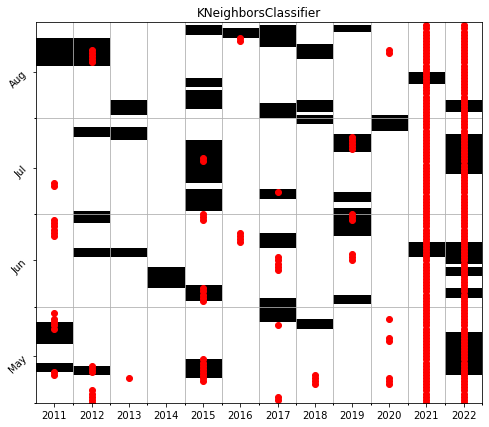

In [109]:
plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)

In [52]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
clf_LR.fit(X_train, Y_train)
predictions = clf_LR.predict(X_test)
Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)
f1_score(Y_test, Y_pred)

0.30442477876106194

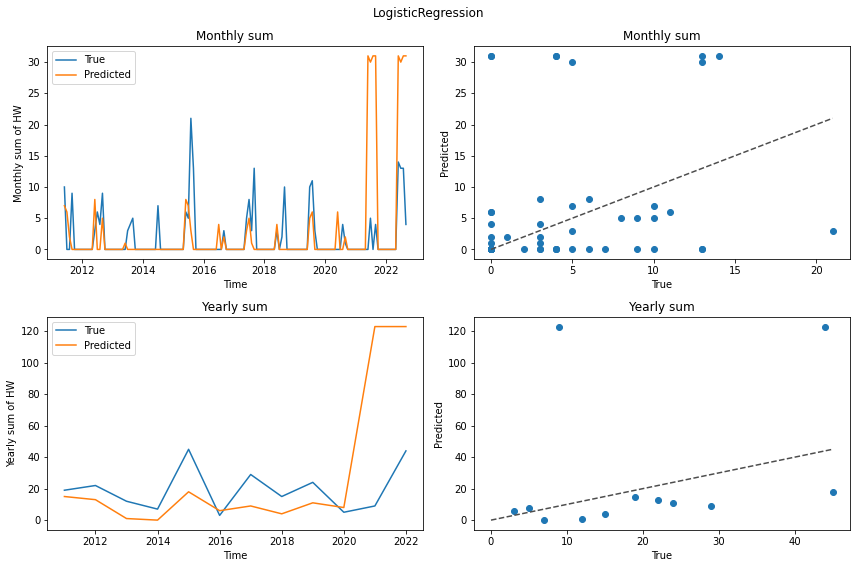

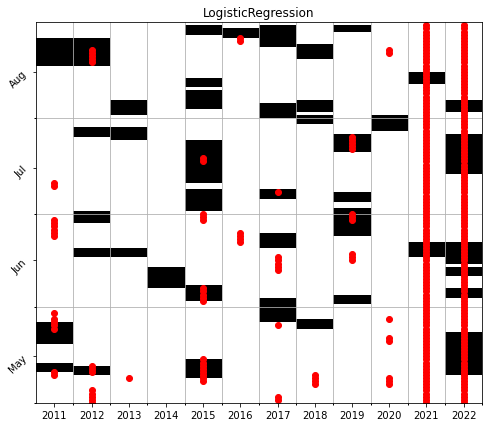

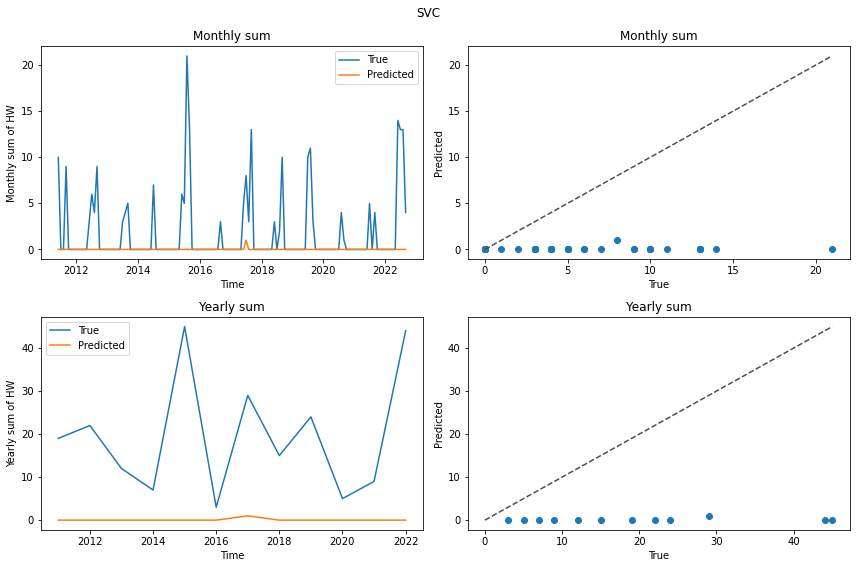

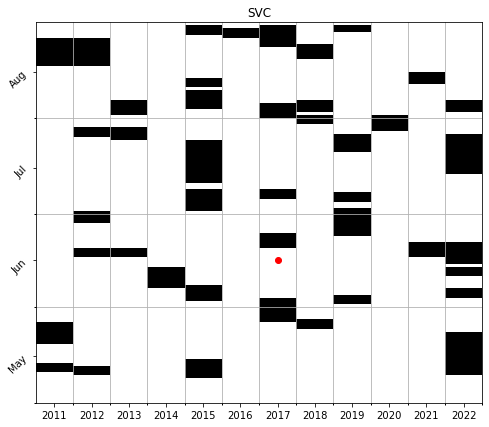

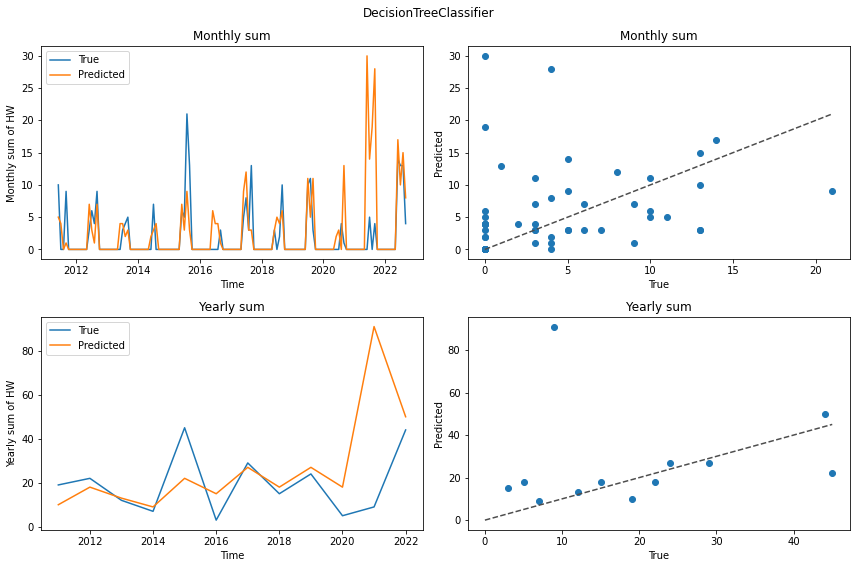

...

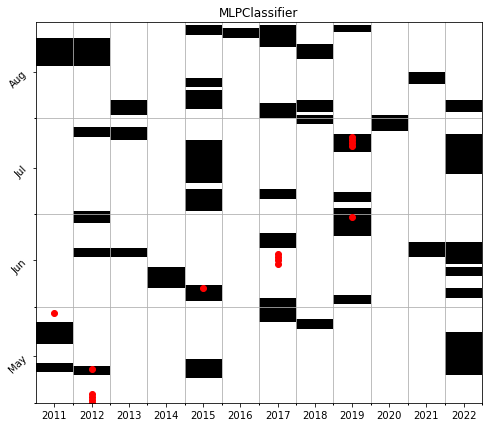

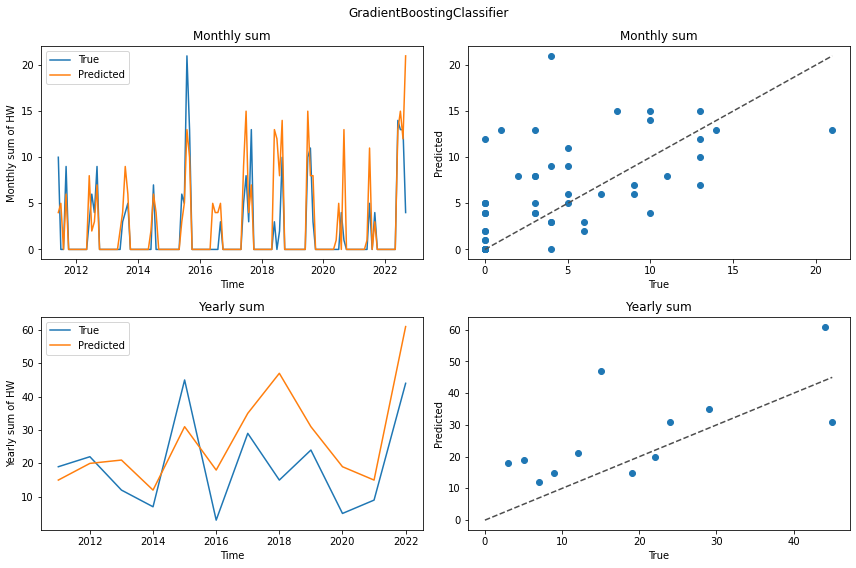

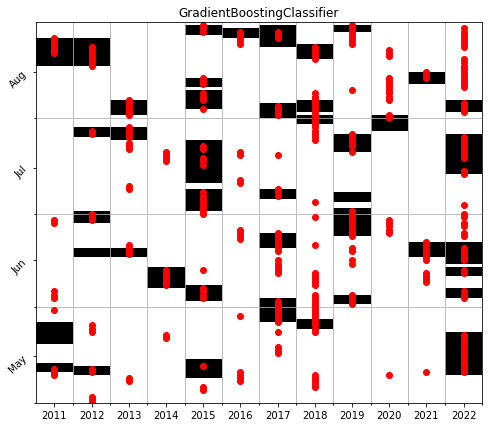

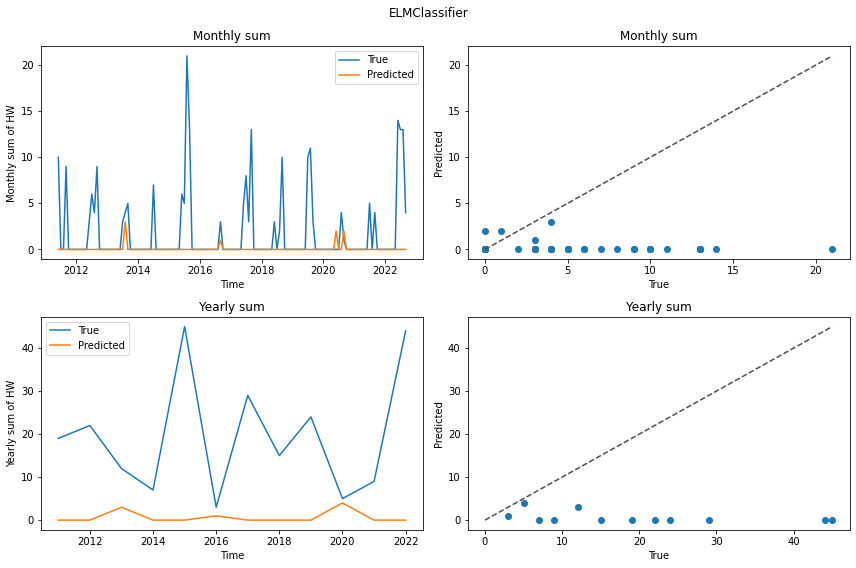

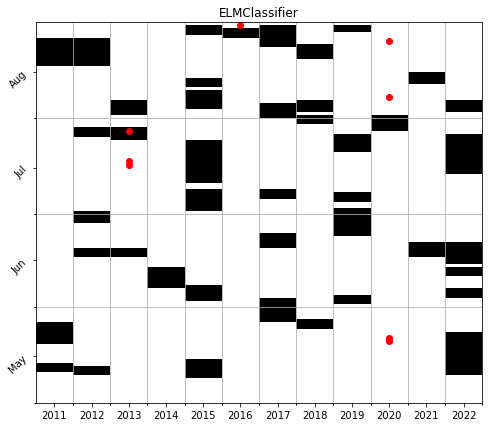

In [ ]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]

    
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)
    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [ ]:
from functions import divide_variables_deep,deep_learning_model

In [ ]:
#DL 
X_train_deep ,Y_train_deep,X_test_deep,Y_test_deep = divide_variables_deep(pred_dataframe,target_dataset,train_indices,test_indices,Y_column,time_lags,time_sequences,False)
model_RNN = deep_learning_model(X_train_deep,Y_train_deep,'RNN',[64,32],[32,16],'binary_crossentropy','Adam','relu',1000,32,50,0)
model_LSTM = deep_learning_model(X_train_deep,Y_train_deep,'LSTM',[64,32],[32,16],'binary_crossentropy','Adam','relu',1000,32,50,0)
model_GRU = deep_learning_model(X_train_deep,Y_train_deep,'GRU',[64,32],[32,16],'binary_crossentropy','Adam','relu',1000,32,50,0)
model_CNN1D = deep_learning_model(X_train_deep,Y_train_deep,'CNN1D',[32,32],[64,32],'binary_crossentropy','Adam','relu',1000,32,50,2)
model_CNN2D = deep_learning_model(X_train_deep,Y_train_deep,'CNN2D',[32,32],[64,32],'binary_crossentropy','Adam','relu',1000,32,50,2)

DL_models = [model_RNN, model_LSTM, model_GRU, model_CNN1D, model_CNN2D]
DL_names = ['RNN', 'LSTM', 'GRU', 'CNN1D', 'CNN2D']   

for mod in DL_models:
    predictions = mod.predict(X_test_deep).round()
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()
    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = DL_names[DL_models.index(mod)]
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    # Metrics
    results = results.append({'Method':DL_names[DL_models.index(mod)],
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

KeyboardInterrupt: 

In [ ]:
train_indices.shape[0]

6579

In [111]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.367521,0.259819,0.304425,1.414530,5.915254,25.083333,-3.419037,-8.549020
1,SVC,0.000000,0.000000,0.000000,0.004274,3.949153,19.416667,-0.655971,-2.054720
2,DecisionTreeClassifier,0.371795,0.273585,0.315217,1.358974,4.203390,13.333333,-1.106424,-2.523028
3,RandomForestClassifier,0.034188,0.400000,0.062992,0.085470,3.864407,17.833333,-0.558984,-1.490652
4,GaussianNB,0.914530,0.172859,0.290761,5.290598,17.355932,83.666667,-17.262384,-42.195622
5,KNeighborsClassifier,0.004274,0.071429,0.008065,0.059829,4.000000,18.333333,-0.661000,-1.900137
6,AdaBoostClassifier,0.384615,0.620690,0.474934,0.619658,2.796610,9.916667,0.158723,-0.237118
7,MLPClassifier,0.029915,0.437500,0.056000,0.068376,3.762712,18.166667,-0.543179,-1.737802
8,GradientBoostingClassifier,0.717949,0.516923,0.601073,1.388889,3.135593,10.916667,0.075386,0.007296
9,ELMClassifier,0.021368,0.294118,0.039841,0.072650,3.847458,18.083333,-0.587003,-1.786594


#### Best Solutions

In [27]:
threshold = 0.25
board_filtered = board_100/len(arrays)
board_filtered = np.where(board_filtered>threshold,1,0)

Text(0, 0.5, 'Days to target')

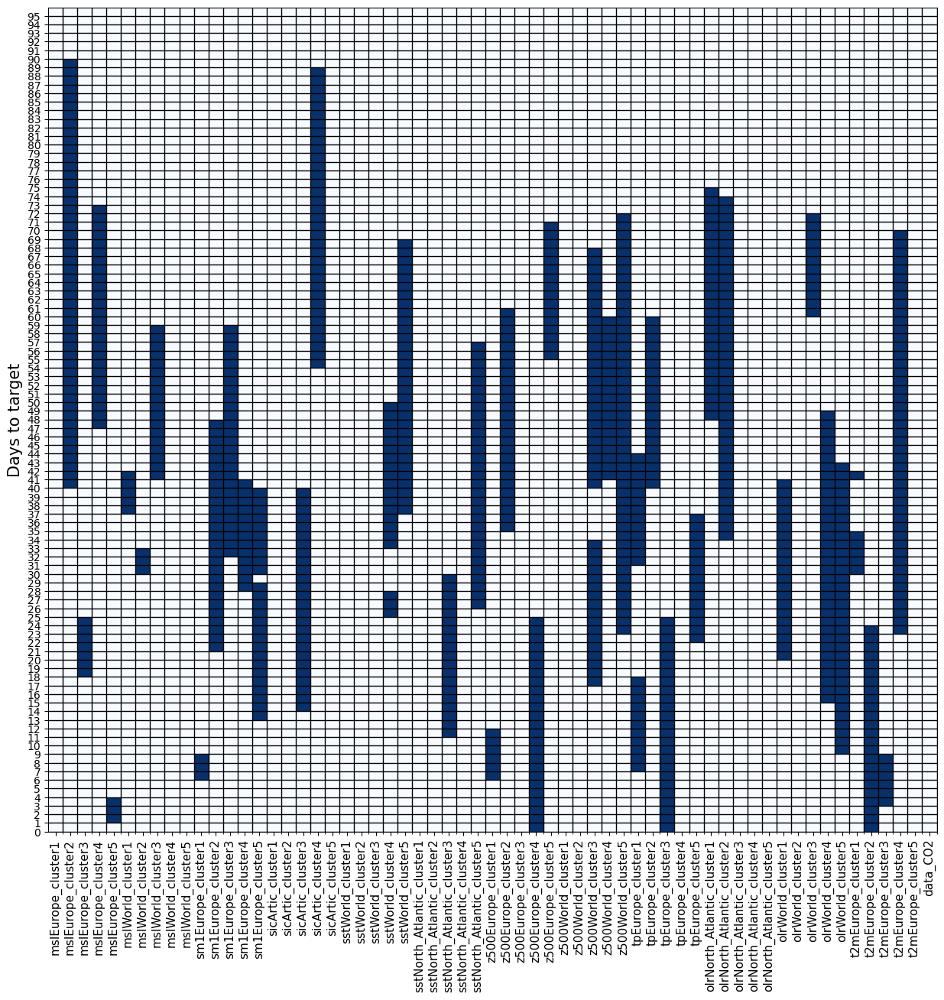

In [28]:
plt.figure(figsize=(15, 14))
plt.imshow(board_filtered, cmap='Blues', origin='lower',aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_filtered.shape[0])-0.5,np.arange(board_filtered.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.ylabel('Days to target',fontsize=15)

In [29]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_filtered.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

In [30]:
train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

In [31]:
X_train = np.array(X_train)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]
X_test = np.array(X_test)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]

In [32]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)

    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

ModuleNotFoundError: No module named 'skelm'

In [176]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.170940,0.357143,0.231214,0.478632,3.661017,12.333333,-0.387999,-0.689922
1,SVC,0.000000,0.000000,0.000000,0.000000,3.966102,19.500000,-0.666748,-2.080711
2,DecisionTreeClassifier,0.376068,0.263473,0.309859,1.427350,4.745763,18.500000,-1.577712,-2.967168
3,RandomForestClassifier,0.034188,0.500000,0.064000,0.068376,3.694915,18.166667,-0.451220,-1.557228
4,GaussianNB,0.970085,0.163899,0.280420,5.918803,19.576271,95.916667,-20.491708,-50.879161
5,KNeighborsClassifier,0.029915,0.225806,0.052830,0.132479,3.881356,18.583333,-0.693330,-1.788418
6,AdaBoostClassifier,0.405983,0.650685,0.500000,0.623932,2.745763,9.833333,0.228411,0.030552
7,MLPClassifier,0.021368,0.357143,0.040323,0.059829,3.864407,18.333333,-0.593468,-1.818057
8,GradientBoostingClassifier,0.717949,0.516923,0.601073,1.388889,3.135593,10.916667,0.075386,0.007296
9,ELMClassifier,0.021368,0.294118,0.039841,0.072650,3.881356,18.083333,-0.609992,-1.869585


#### Voting ensemble (test)

In [128]:
# Voting Ensemble
preds = []
from sklearn import model_selection
for threshold in np.arange(0.2,1,0.05):
    board_filtered = board_100/len(arrays)
    board_filtered = np.where(board_filtered>threshold,1,0)


    time_lags = np.repeat(0,pred_dataframe.shape[1])
    time_sequences = np.repeat(board_filtered.shape[0],pred_dataframe.shape[1])
    variable_selection = np.repeat(1,pred_dataframe.shape[1])
    # print(solution)
    # if sum(variable_selection) == 0:
    #     return 100000


    # Create dataset according to solution
    dataset_opt = target_dataset.copy()
    for i,col in enumerate(pred_dataframe.columns):
        if variable_selection[i] == 0:
            continue
        for j in range(time_sequences[i]):
            dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

    train_dataset_opt = dataset_opt[train_indices]
    test_dataset_opt = dataset_opt[test_indices]

    Y_column = 'Target' 
                
    X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
    Y_train=train_dataset_opt[Y_column]

    X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
    Y_test=test_dataset_opt[Y_column]
        
    from sklearn import preprocessing
    scaler = preprocessing.StandardScaler()
    X_std_train = scaler.fit(X_train)

    X_std_train = scaler.transform(X_train)
    X_std_val = scaler.transform(X_test)

    X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
    X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

    X_train = np.array(X_train)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]
    X_test = np.array(X_test)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]


    from sklearn.linear_model import LogisticRegression
    clf_LR = LogisticRegression()
    clf_LR.fit(X_train, Y_train)
    predictions = clf_LR.predict(X_test)
# Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)
    f1 = f1_score(Y_test, predictions)
    print(f1)

    preds.append(predictions)

0.2571428571428571
0.23121387283236997


KeyboardInterrupt: 

In [82]:
majority = np.where(np.array(preds).sum(axis=0)>np.array(preds).shape[0]/2,1,0)
f1_score(Y_test, majority)

0.5301204819277108

In [29]:
# Voting Ensemble
preds = []
for elitism in np.arange(0.1,0.6,0.1):
    print(elitism)
    best100_index = sol_file_av.sort_values(by=['CV'],ascending=False).head(int(elitism*sol_file_av.shape[0])).index

    arrays = []
    for ind in best100_index:
        array = np.fromstring(sol_file_av.Sol[ind].replace('[', '').replace(']', '').replace('\n', ''), dtype=float, sep=' ')
        arrays.append(array)

    n_rows = int(((sequence_length + final_sequence)*feat_sel).max())+5
    n_cols = len(column_names)

    board_100 = np.zeros((n_rows, n_cols))
    discarded = np.zeros((1, n_cols))

    for array in arrays:
        final_sequence = array[len(column_names):2*len(column_names)]
        sequence_length = array[:len(column_names)]
        feat_sel = array[2*len(column_names):]
        column_names = pred_dataframe_opt.columns.tolist()

        for i in range(n_cols):
            start_index = int(final_sequence[i])
            end_index = int(final_sequence[i]) + int(sequence_length[i])
            

            if feat_sel[i]==0:
                discarded[0,i] += 1
            else:
                board_100[start_index:end_index, i] += 1
        
    board_100[0,:].shape



    for threshold in np.arange(0.2,1,0.05):
        # print(threshold)
        board_filtered = board_100/len(arrays)
        board_filtered = np.where(board_filtered>threshold,1,0)


        time_lags = np.repeat(0,pred_dataframe.shape[1])
        time_sequences = np.repeat(board_filtered.shape[0],pred_dataframe.shape[1])
        variable_selection = np.repeat(1,pred_dataframe.shape[1])
        # print(solution)
        # if sum(variable_selection) == 0:
        #     return 100000


        # Create dataset according to solution
        dataset_opt = target_dataset.copy()
        for i,col in enumerate(pred_dataframe.columns):
            if variable_selection[i] == 0:
                continue
            for j in range(time_sequences[i]):
                dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

        train_dataset_opt = dataset_opt[train_indices]
        test_dataset_opt = dataset_opt[test_indices]

        Y_column = 'Target' 
                    
        X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
        Y_train=train_dataset_opt[Y_column]

        X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
        Y_test=test_dataset_opt[Y_column]
            
        from sklearn import preprocessing
        scaler = preprocessing.StandardScaler()
        X_std_train = scaler.fit(X_train)

        X_std_train = scaler.transform(X_train)
        X_std_val = scaler.transform(X_test)

        X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
        X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

        X_train = np.array(X_train)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]
        X_test = np.array(X_test)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]


        from sklearn.linear_model import LogisticRegression
        clf_LR = LogisticRegression()
        clf_LR.fit(X_train, Y_train)
        predictions = clf_LR.predict(X_test)
    # Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)
        f1 = f1_score(Y_test, predictions)
        print(f1)

        preds.append(predictions)

0.1


NameError: name 'f1_score' is not defined

In [84]:
majority = np.where(np.array(preds).sum(axis=0)>np.array(preds).shape[0]/2,1,0)
f1_score(Y_test, majority)

0.503875968992248

In [30]:
n_rows = int(((sequence_length + final_sequence)*feat_sel).max())+5
n_cols = len(column_names)

board_100 = np.zeros((n_rows, n_cols))
discarded = np.zeros((1, n_cols))

for array in arrays:
    final_sequence = array[len(column_names):2*len(column_names)]
    sequence_length = array[:len(column_names)]
    feat_sel = array[2*len(column_names):]
    column_names = pred_dataframe_opt.columns.tolist()

    for i in range(n_cols):
        start_index = int(final_sequence[i])
        end_index = int(final_sequence[i]) + int(sequence_length[i])
        

        if feat_sel[i]==0:
            discarded[0,i] += 1
        else:
            board_100[start_index:end_index, i] += 1
    
board_100[0,:].shape

(35,)

#### Benchmarks

In [118]:
board_benchmark = np.where(board_100>0.5,0,0)

In [119]:
board_benchmark[:7,:]=1
board_benchmark

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

Text(0, 0.5, 'Days to target')

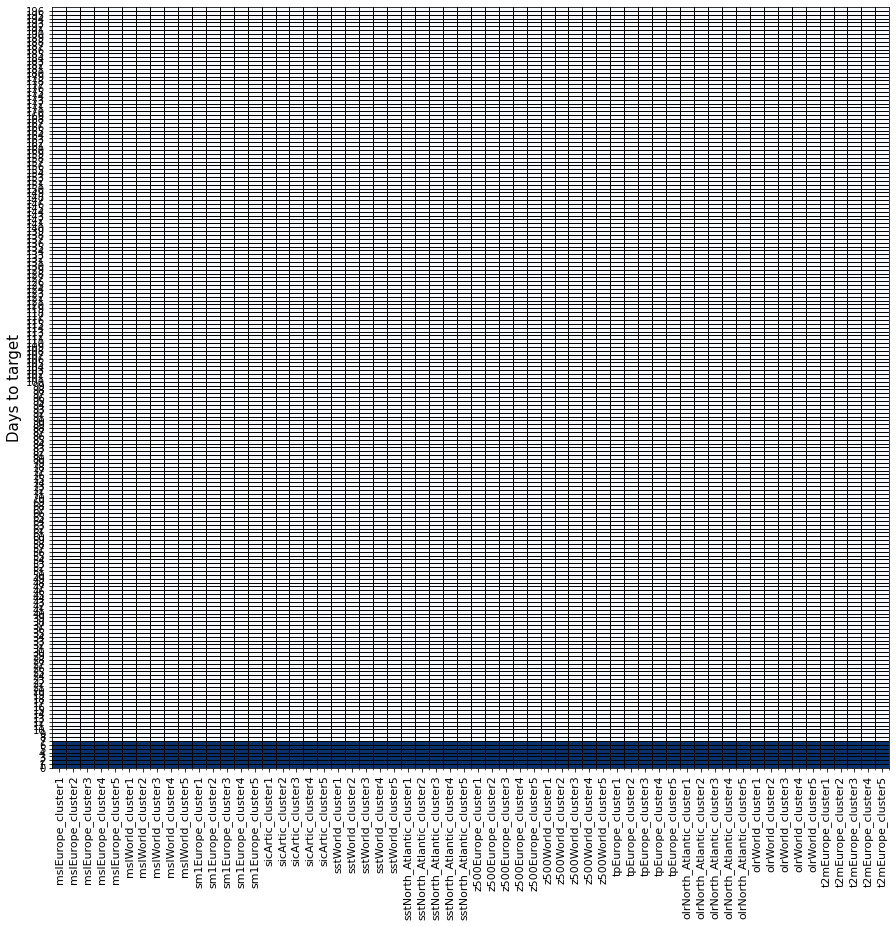

In [120]:
plt.figure(figsize=(15, 14))
plt.imshow(board_benchmark, cmap='Blues', origin='lower',aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_benchmark.shape[0])-0.5,np.arange(board_benchmark.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.ylabel('Days to target',fontsize=15)

In [121]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_benchmark.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

X_train = np.array(X_train)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]
X_test = np.array(X_test)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]

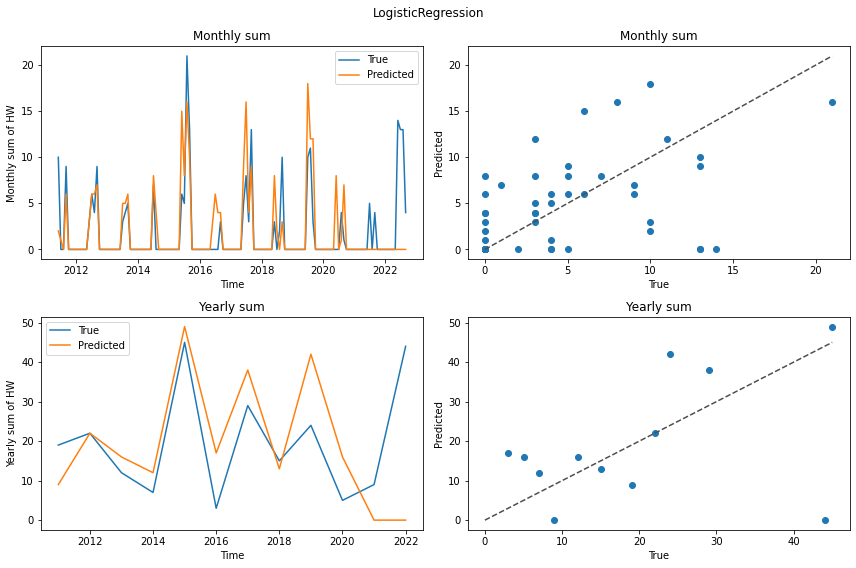

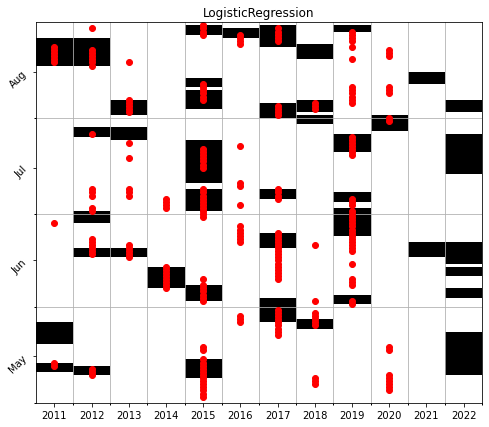

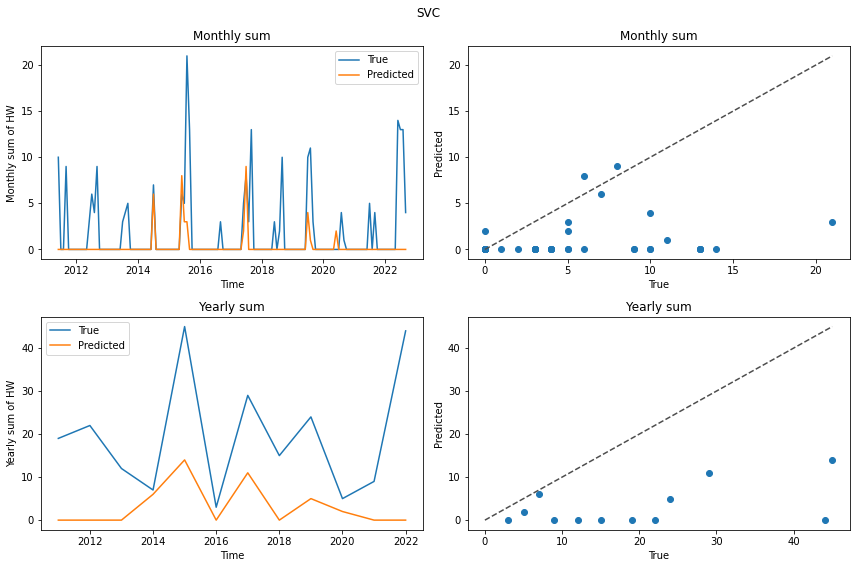

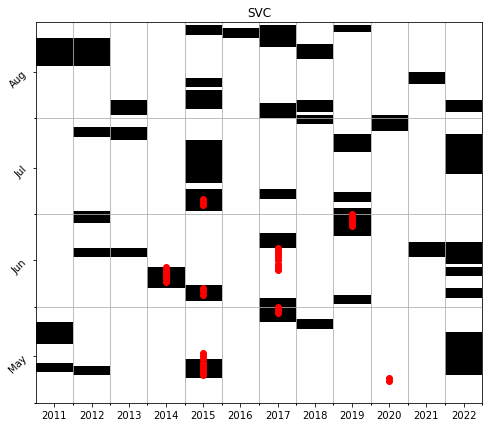

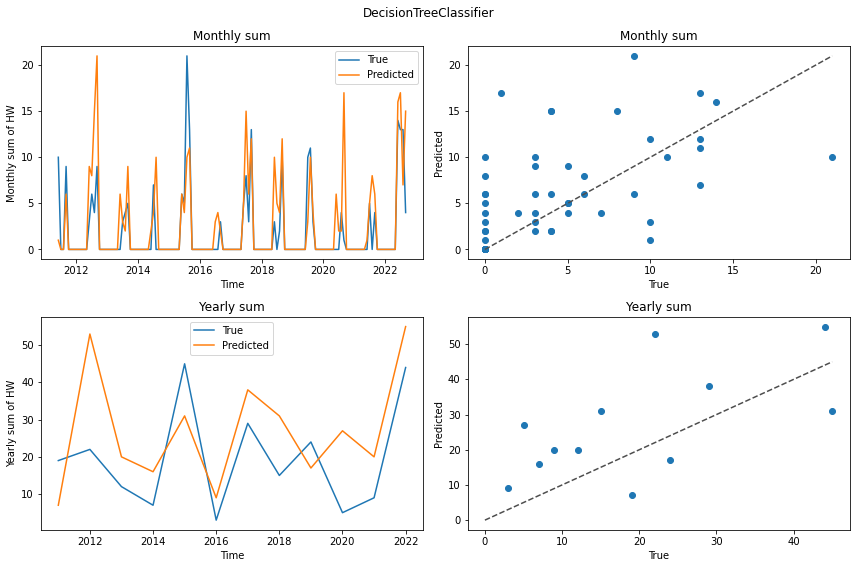

...

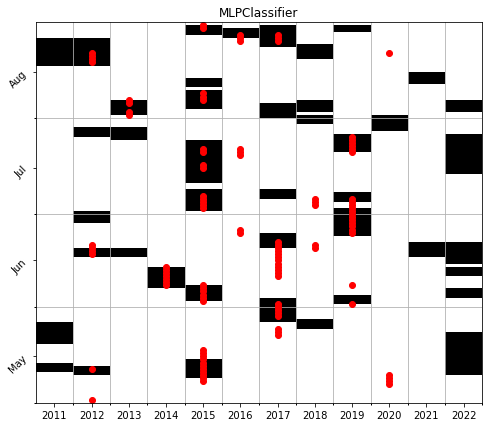

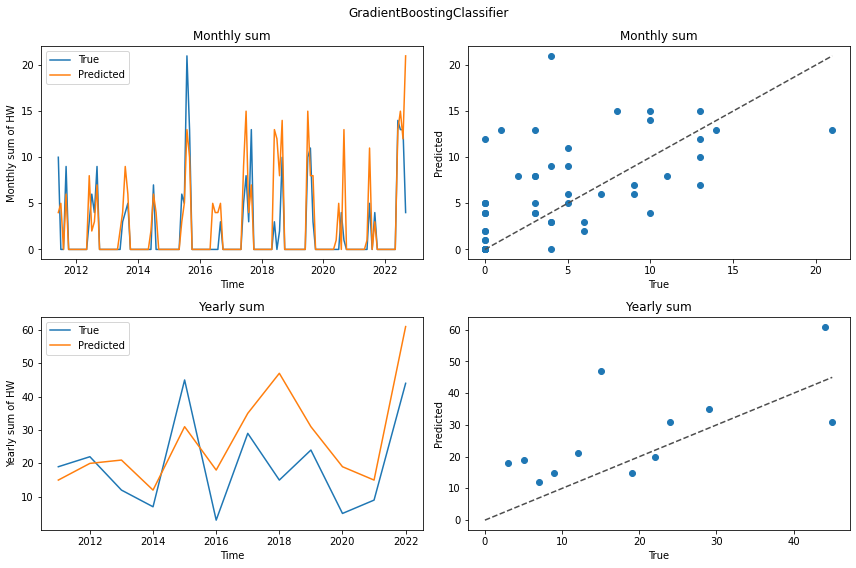

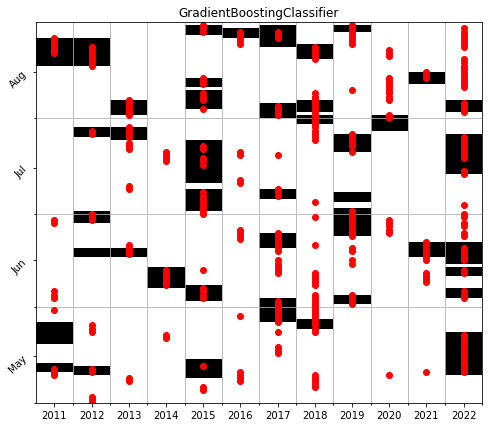

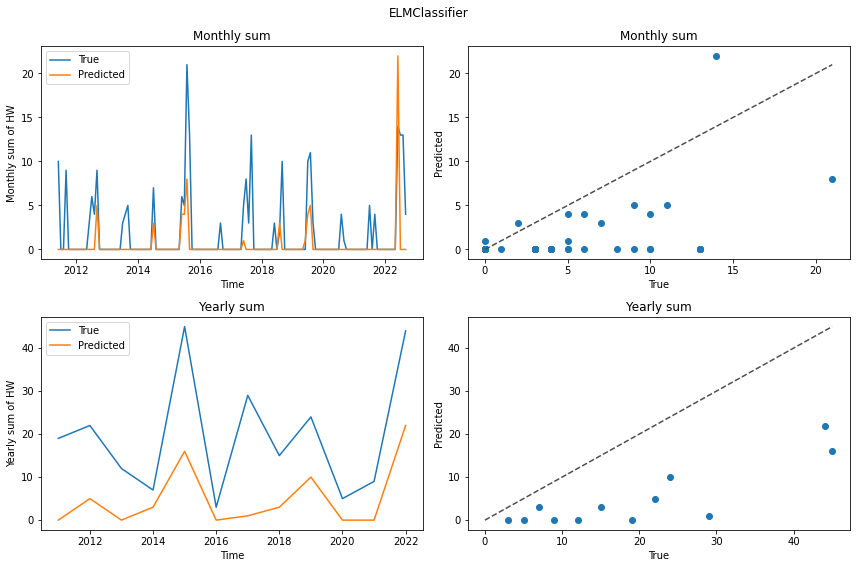

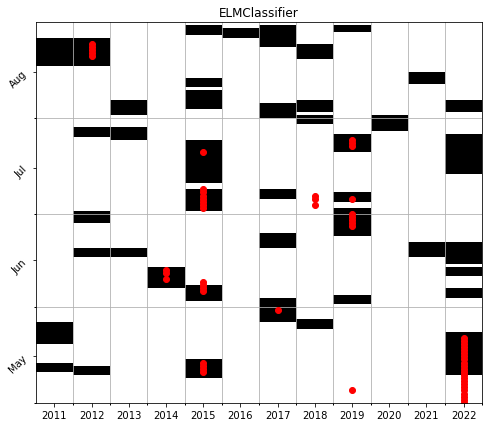

In [122]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)

    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [123]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.504274,0.504274,0.504274,1.000000,3.050847,10.833333,0.054552,-0.322389
1,SVC,0.106838,0.657895,0.183824,0.162393,3.491525,16.333333,-0.395183,-1.232558
2,DecisionTreeClassifier,0.435897,0.314815,0.365591,1.384615,3.186441,13.000000,-0.044591,-0.182855
3,RandomForestClassifier,0.213675,0.781250,0.335570,0.273504,2.915254,14.166667,0.027251,-0.551300
4,GaussianNB,0.773504,0.163210,0.269546,4.739316,16.627119,81.750000,-15.659576,-39.874145
5,KNeighborsClassifier,0.017094,0.266667,0.032129,0.064103,3.779661,18.250000,-0.584129,-1.835841
6,AdaBoostClassifier,0.388889,0.619048,0.477690,0.628205,2.559322,9.583333,0.237750,-0.208846
7,MLPClassifier,0.303419,0.628319,0.409222,0.482906,2.932203,10.916667,-0.003641,-0.349293
8,GradientBoostingClassifier,0.717949,0.516923,0.601073,1.388889,3.135593,10.916667,0.075386,0.007296
9,ELMClassifier,0.188034,0.733333,0.299320,0.256410,3.288136,14.500000,-0.150918,-0.538532


One of each seven days

In [133]:
board_benchmark = np.where(board_100>0.5,0,0)

board_benchmark[::7,:]=1
board_benchmark

array([[1, 1, 1, ..., 1, 1, 1],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [1, 1, 1, ..., 1, 1, 1]])

Text(0, 0.5, 'Days to target')

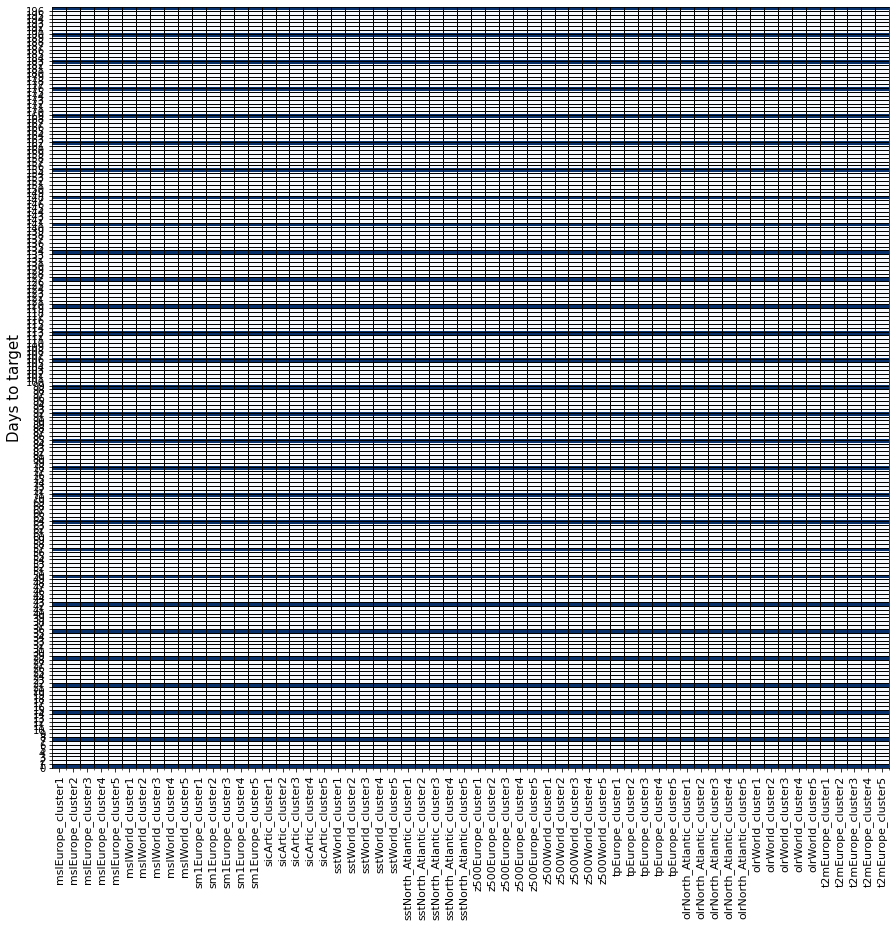

In [134]:
plt.figure(figsize=(15, 14))
plt.imshow(board_benchmark, cmap='Blues', origin='lower',aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_benchmark.shape[0])-0.5,np.arange(board_benchmark.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.ylabel('Days to target',fontsize=15)

In [135]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_benchmark.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

X_train = np.array(X_train)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]
X_test = np.array(X_test)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]

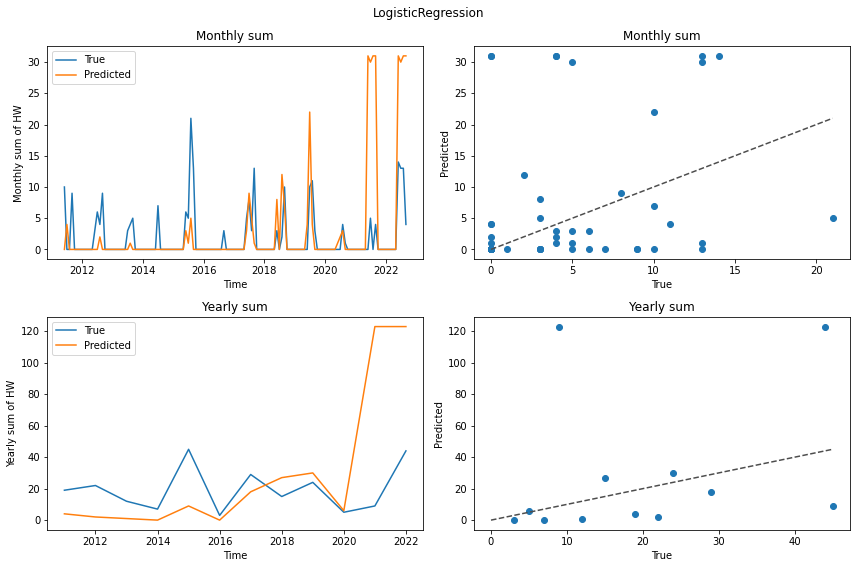

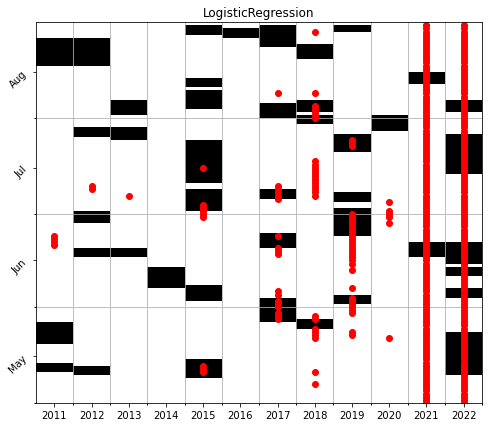

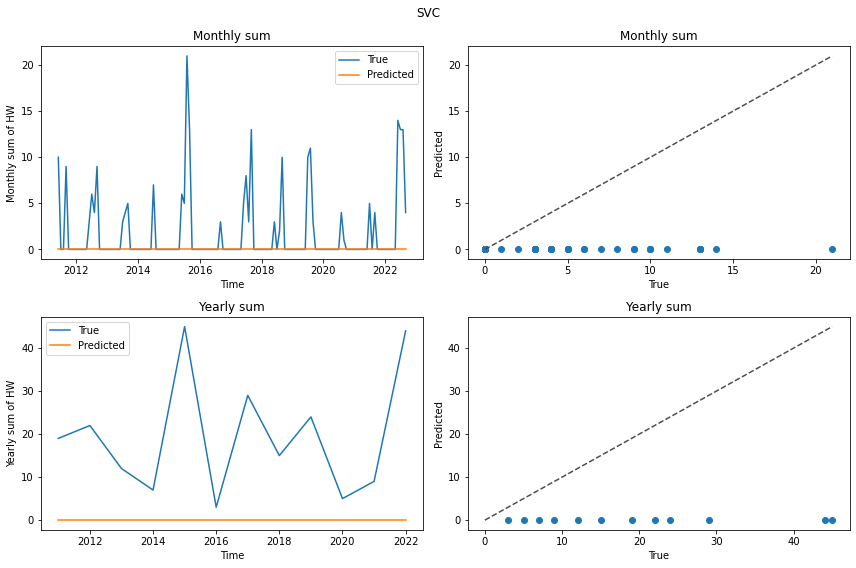

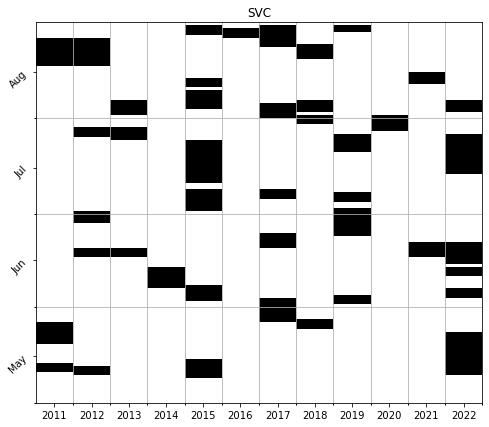

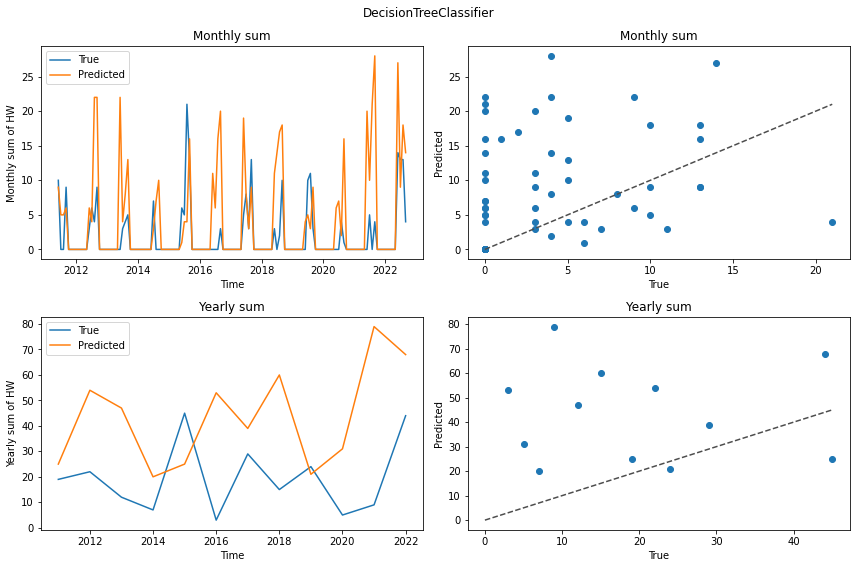

...

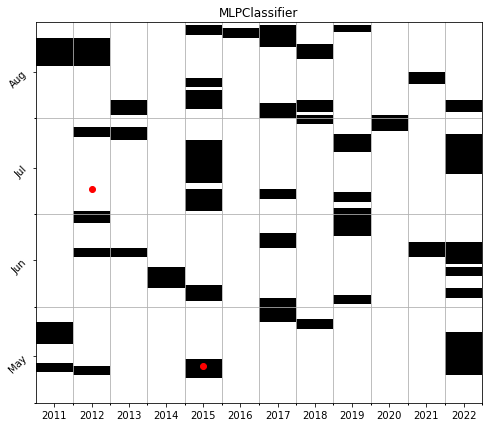

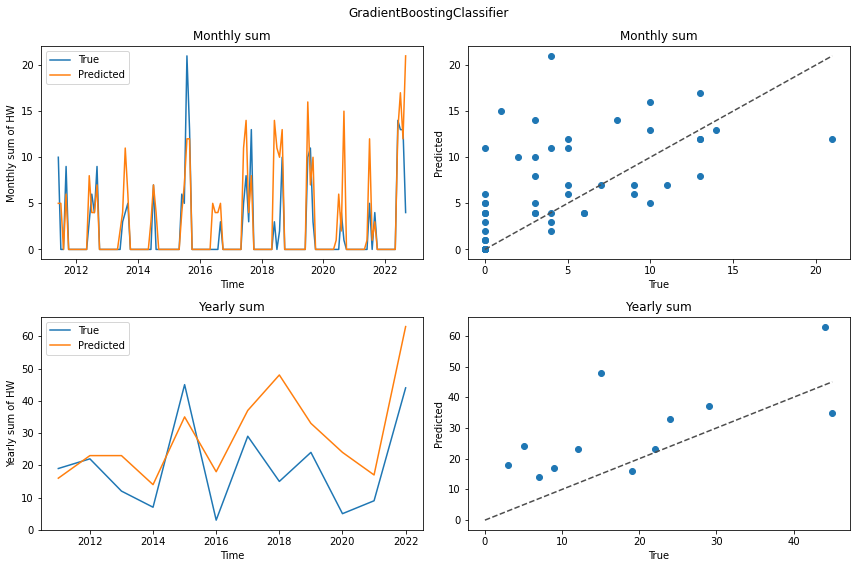

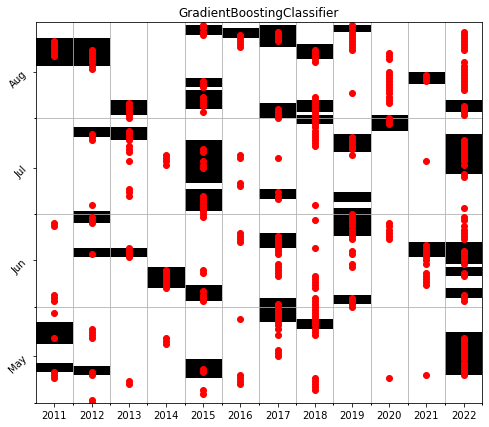

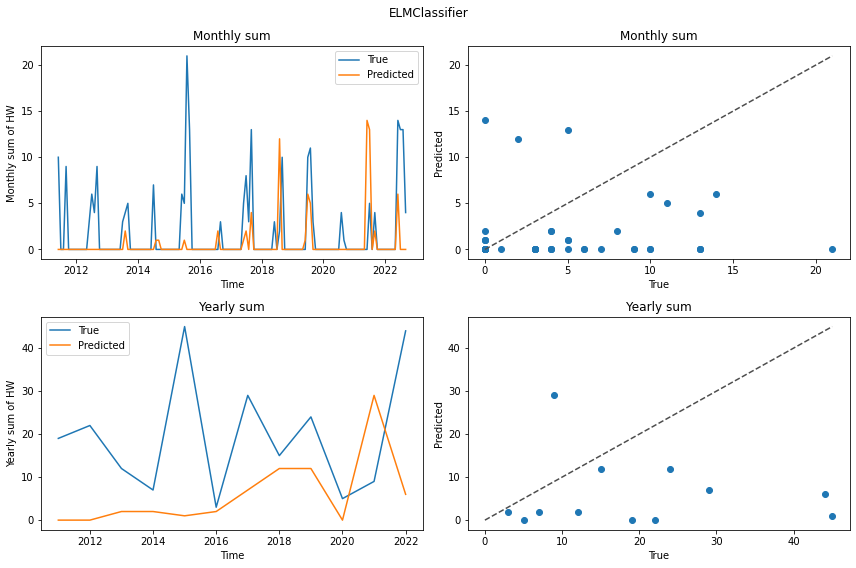

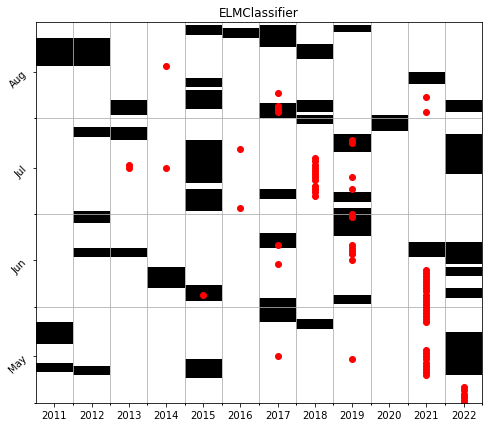

In [136]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)

    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [137]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.384615,0.262391,0.311958,1.465812,6.084746,26.250000,-3.523927,-8.867305
1,SVC,0.000000,0.000000,0.000000,0.000000,3.966102,19.500000,-0.666748,-2.080711
2,DecisionTreeClassifier,0.440171,0.197318,0.272487,2.230769,6.779661,27.833333,-2.800472,-5.219790
3,RandomForestClassifier,0.081197,0.311475,0.128814,0.260684,3.881356,16.750000,-0.693330,-1.266758
4,GaussianNB,0.833333,0.152344,0.257596,5.470085,18.949153,88.833333,-20.039818,-49.912905
5,KNeighborsClassifier,0.000000,0.000000,0.000000,0.004274,3.949153,19.416667,-0.660282,-2.054720
6,AdaBoostClassifier,0.286325,0.620370,0.391813,0.461538,2.983051,10.500000,-0.116434,-0.603283
7,MLPClassifier,0.004274,0.500000,0.008475,0.008547,3.932203,19.333333,-0.653816,-2.020520
8,GradientBoostingClassifier,0.739316,0.492877,0.591453,1.500000,3.271186,11.916667,-0.029504,-0.151391
9,ELMClassifier,0.038462,0.123288,0.058632,0.311966,3.983051,16.750000,-0.579818,-1.468308


First 15 days

In [138]:
board_benchmark = np.where(board_100>0.5,0,0)

board_benchmark[:15,:]=1
board_benchmark

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

Text(0, 0.5, 'Days to target')

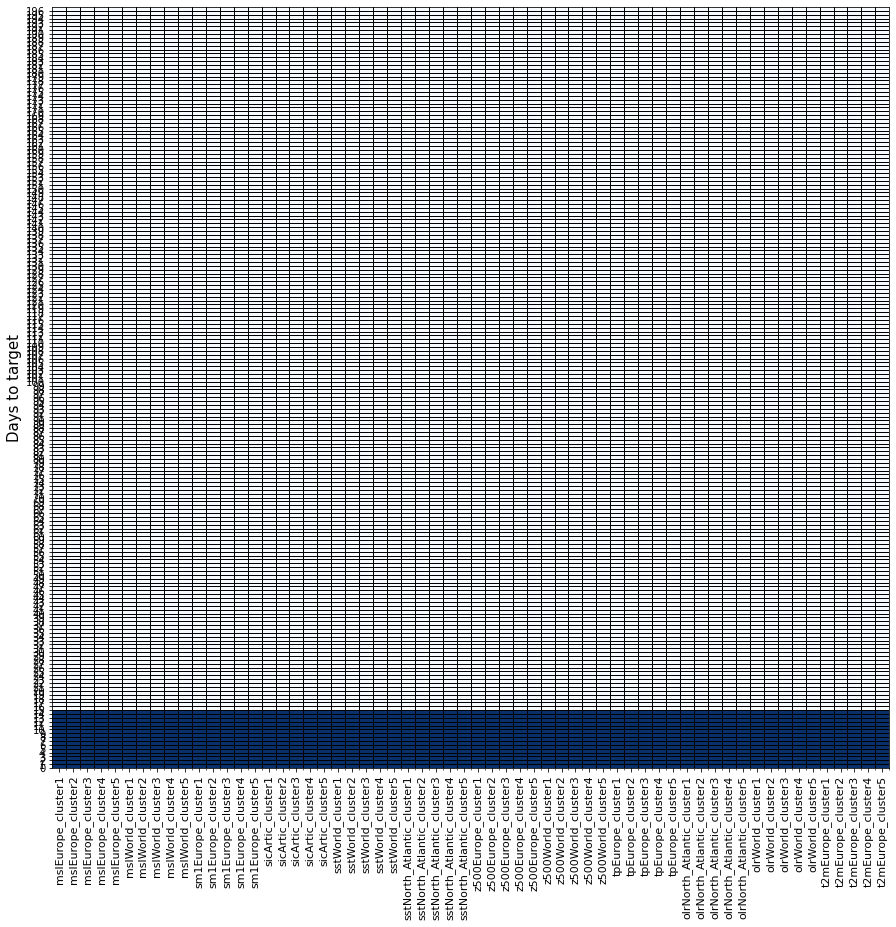

In [139]:
plt.figure(figsize=(15, 14))
plt.imshow(board_benchmark, cmap='Blues', origin='lower',aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_benchmark.shape[0])-0.5,np.arange(board_benchmark.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.ylabel('Days to target',fontsize=15)

In [140]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_benchmark.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

X_train = np.array(X_train)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]
X_test = np.array(X_test)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]

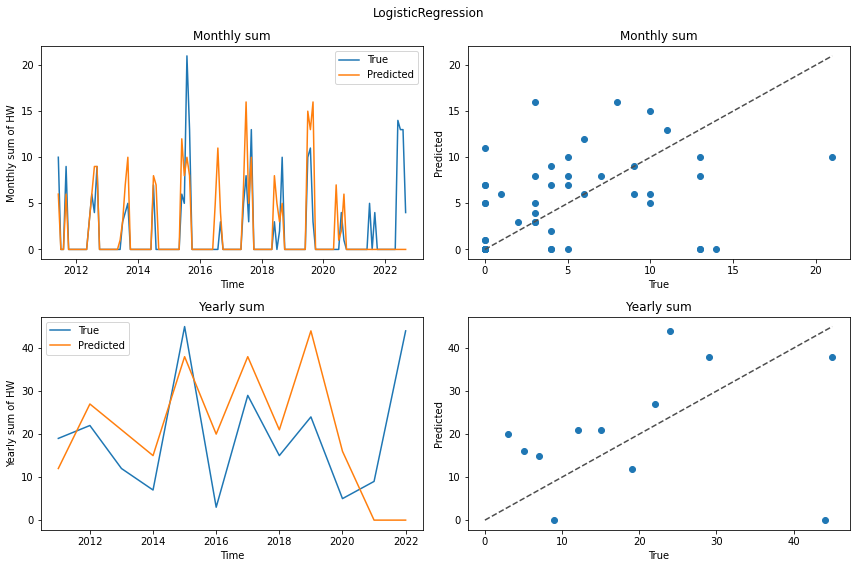

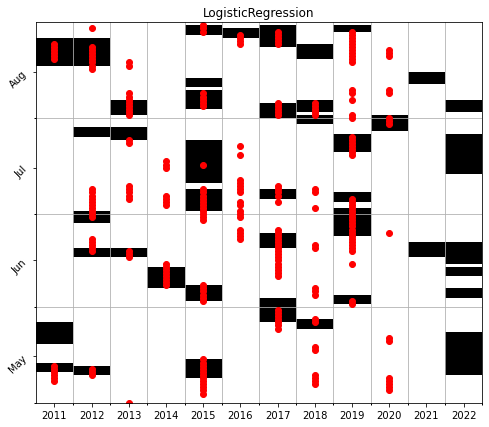

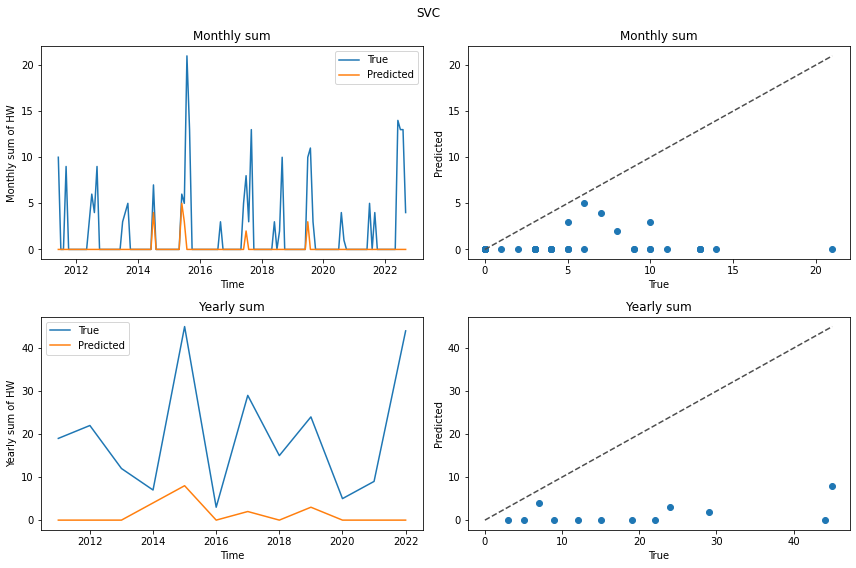

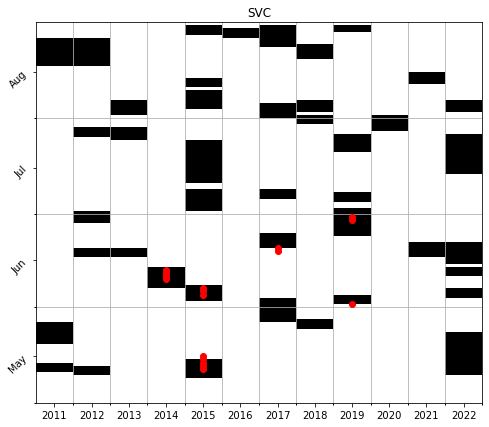

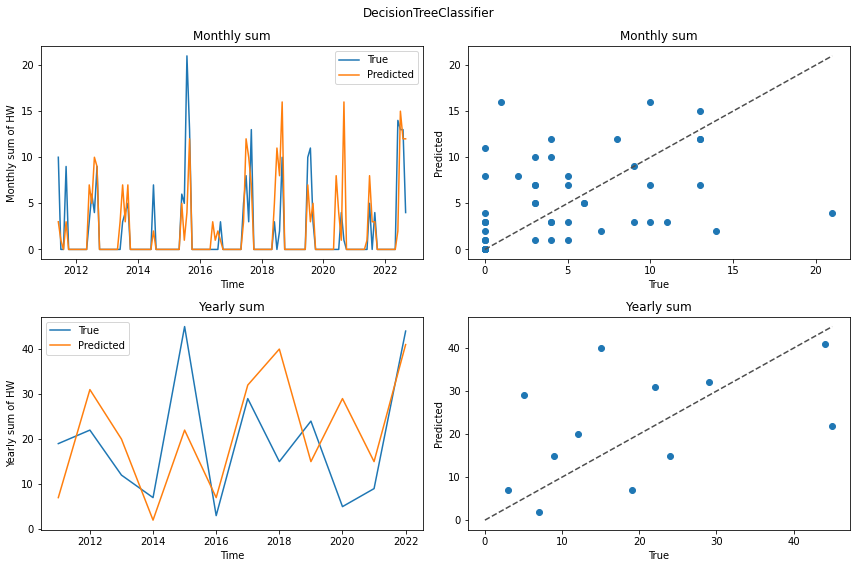

...

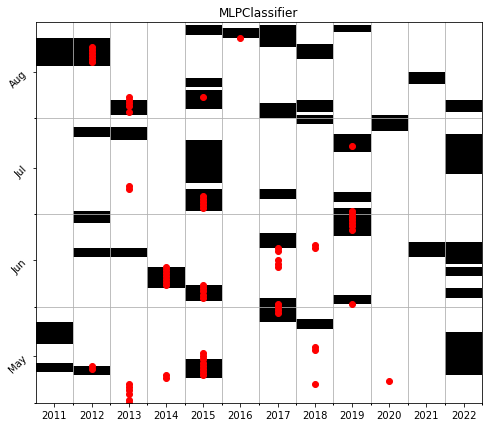

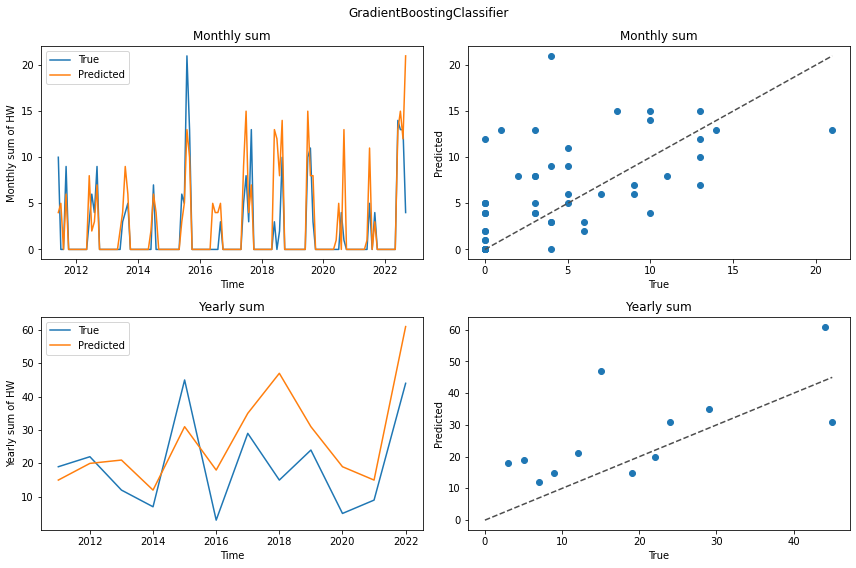

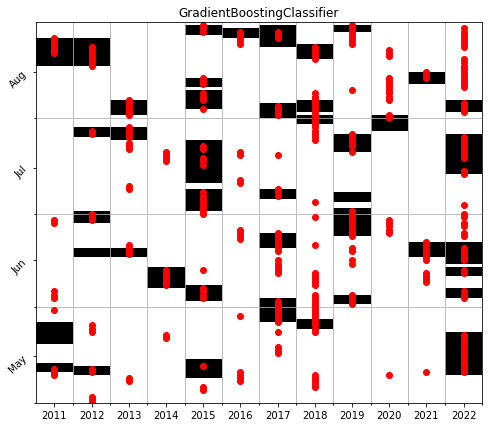

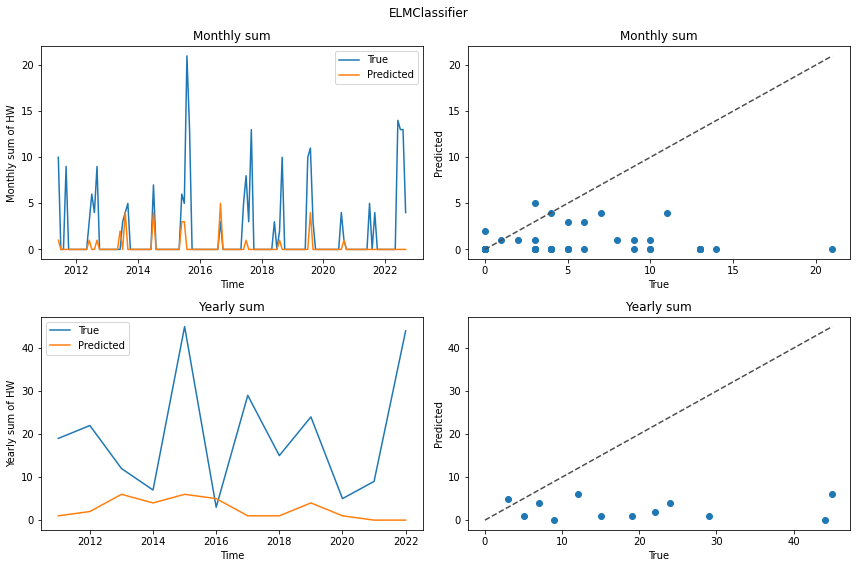

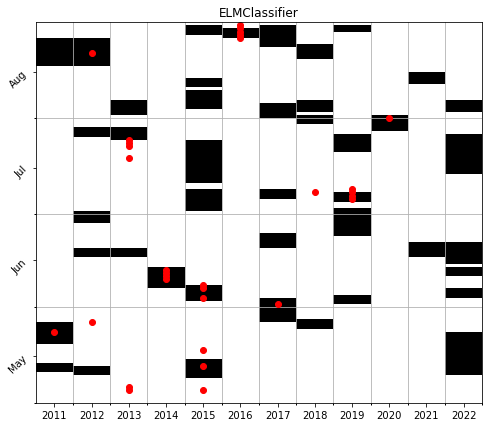

In [141]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)

    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [142]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.491453,0.456349,0.473251,1.076923,3.220339,12.666667,-0.076202,-0.464660
1,SVC,0.059829,0.823529,0.111554,0.072650,3.677966,18.083333,-0.541023,-1.650707
2,DecisionTreeClassifier,0.423077,0.379310,0.400000,1.115385,3.203390,10.916667,-0.038125,-0.000912
3,RandomForestClassifier,0.119658,0.459016,0.189831,0.260684,3.508475,15.250000,-0.331243,-0.974008
4,GaussianNB,0.961538,0.170584,0.289762,5.636752,18.694915,91.916667,-19.362342,-49.460100
5,KNeighborsClassifier,0.000000,0.000000,0.000000,0.021368,3.881356,19.083333,-0.617176,-2.023712
6,AdaBoostClassifier,0.482906,0.710692,0.575064,0.679487,2.186441,8.750000,0.385746,0.086639
7,MLPClassifier,0.196581,0.621622,0.298701,0.316239,3.152542,13.833333,-0.219887,-0.823985
8,GradientBoostingClassifier,0.717949,0.516923,0.601073,1.388889,3.135593,10.916667,0.075386,0.007296
9,ELMClassifier,0.072650,0.548387,0.128302,0.132479,3.576271,17.250000,-0.496481,-1.602371
